In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from mlxtend.plotting import scatterplotmatrix as spx
from mlxtend.plotting import heatmap
import numpy as np
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score
from sklearn.model_selection import cross_val_score, LeaveOneOut
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.base import clone
from itertools import combinations
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet, LassoCV, ElasticNetCV, RidgeCV
from sklearn.cluster import KMeans, DBSCAN
from sklearn.linear_model import RANSACRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures as PF
from sklearn.tree import DecisionTreeRegressor as DTR # не требует стандартизации/нормализации
from sklearn.ensemble import RandomForestRegressor as RFR
from sklearn.svm import SVR
from sklearn.pipeline import make_pipeline
from sklearn.decomposition import PCA
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsRegressor as KNNR
from sklearn.ensemble import StackingRegressor, BaggingRegressor, VotingRegressor as VoteReg, GradientBoostingRegressor as GBReg
from sklearn.feature_selection import RFE, SequentialFeatureSelector
import warnings
warnings.filterwarnings('ignore')

In [ ]:
np.random.seed(1)

In [ ]:
df = pd.read_csv('housing.csv')

**Описание датасета**

Статистические данные о ряде домов в Калифорнии, основанные на переписи 1990 года.

* **longitude** - долгота
* **latitude** - широта
* **housing_median_age** - средний возраст дома
* **total_rooms** - общее количество комнат
* **total_bedrooms** - общее количество спален
* **population** - количество проживающих
* **households** - домохозяйства
* **ocean_proximity** - близость океана
* **median_income** - средний доход
* **median_house_value** - средняя стоимость дома

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  19918 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20041 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
 10  id                  20640 non-null  int64  
dtypes: float64(9), int64(1), object(1)
memory usage: 1.7+ MB


In [ ]:
df.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,id
count,20640.000000,20640.000000,19918.000000,20640.000000,20433.000000,20041.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.471242,35.036934,28.653630,2635.763081,537.870553,1425.418243,499.539680,3.870671,206855.816909,10319.500000
std,5.041408,94.903955,12.576796,2181.615252,421.385070,1135.185798,382.329753,1.899822,115395.615874,5958.399114
min,-124.350000,-13534.030000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000,0.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,786.000000,280.000000,2.563400,119600.000000,5159.750000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1165.000000,409.000000,3.534800,179700.000000,10319.500000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1726.000000,605.000000,4.743250,264725.000000,15479.250000
max,122.030000,1327.130000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000,20639.000000


In [ ]:
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,id
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,0
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,1
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY,2
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY,3
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY,4


In [ ]:
df.drop('id', axis=1, inplace=True)

In [ ]:
def reduce_mem_usage(df):
    """ iterate through all the columns of a dataframe and modify the data type
        to reduce memory usage.        
    """
    start_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage of dataframe is {:.2f} MB'.format(start_mem))
    
    for col in df.columns:
        col_type = df[col].dtype
        
        if col_type != object:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)
        else:
            df[col] = df[col].astype('category')

    end_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))
    
    return df

In [ ]:
df = reduce_mem_usage(df)

Memory usage of dataframe is 1.57 MB
Memory usage after optimization is: 0.73 MB
Decreased by 53.7%


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   longitude           20640 non-null  float32 
 1   latitude            20640 non-null  float32 
 2   housing_median_age  19918 non-null  float32 
 3   total_rooms         20640 non-null  float32 
 4   total_bedrooms      20433 non-null  float32 
 5   population          20041 non-null  float32 
 6   households          20640 non-null  float32 
 7   median_income       20640 non-null  float32 
 8   median_house_value  20640 non-null  float32 
 9   ocean_proximity     20640 non-null  category
dtypes: category(1), float32(9)
memory usage: 746.1 KB


In [ ]:
df.isna().sum()

longitude               0
latitude                0
housing_median_age    722
total_rooms             0
total_bedrooms        207
population            599
households              0
median_income           0
median_house_value      0
ocean_proximity         0
dtype: int64

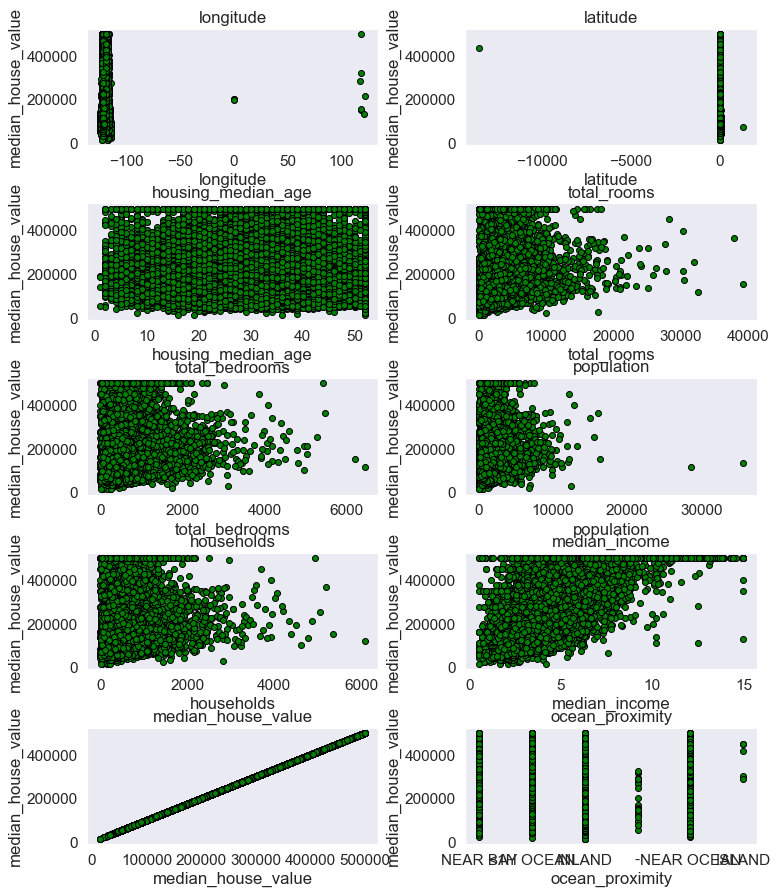

In [ ]:
fig, ax = plt.subplots(nrows=5, ncols=2, figsize=(12, 15))
ax = ax.flatten()
for idx, axe in enumerate(ax):
    axe.scatter(df.iloc[:, idx].values, df['median_house_value'].values, color='green', ec='black')
    axe.set_title(f'{df.columns[idx]}')
    axe.set_xlabel(f'{df.columns[idx]}')
    axe.set_ylabel('median_house_value')
    axe.grid(alpha=0.3)
plt.subplots_adjust(wspace=0.3, hspace=0.5)
plt.show()

In [ ]:
total_rooms_max_value = np.quantile(df['total_rooms'], q=0.975)
total_rooms_min_value = np.quantile(df['total_rooms'], q=0.025)
condition = (df['total_rooms'] > total_rooms_max_value) | (df['total_rooms'] < total_rooms_min_value)
df[condition]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
59,-122.290001,37.820000,2.0,158.0,43.0,94.0,57.0,2.5625,60000.0,NEAR BAY
61,-122.290001,37.820000,49.0,135.0,29.0,86.0,23.0,6.1183,75000.0,NEAR BAY
73,-122.290001,37.810001,46.0,12.0,4.0,18.0,7.0,0.4999,67500.0,NEAR BAY
81,-122.269997,37.810001,52.0,210.0,56.0,183.0,56.0,1.1667,112500.0,NEAR BAY
82,-122.279999,37.810001,52.0,340.0,97.0,200.0,87.0,1.5208,112500.0,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20578,-121.809998,38.840000,37.0,352.0,65.0,238.0,67.0,2.8542,275000.0,INLAND
20620,-121.480003,39.049999,40.0,198.0,41.0,151.0,48.0,4.5625,100000.0,INLAND
20625,-121.519997,39.119999,37.0,102.0,17.0,29.0,14.0,4.1250,72000.0,INLAND
20627,-121.320000,39.130001,5.0,358.0,65.0,169.0,59.0,3.0000,162500.0,INLAND


In [ ]:
df.loc[condition, 'total_rooms'] = df['total_rooms'].median()
df['total_rooms'].describe()

count    20640.000000
mean      2435.698730
std       1358.232666
min        371.000000
25%       1511.000000
50%       2127.000000
75%       3006.000000
max       8069.000000
Name: total_rooms, dtype: float64

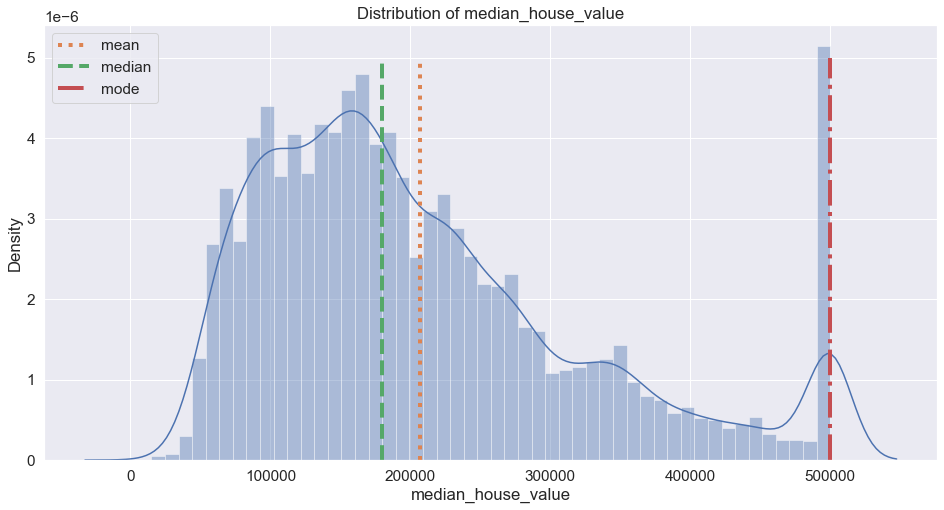

In [ ]:
target_mean = round(df['median_house_value'].mean(), 2)
target_median = df['median_house_value'].median()
target_mode = df['median_house_value'].mode()[0]

plt.figure(figsize = (16, 8))

sns.distplot(df['median_house_value'], bins=50)

y = np.linspace(0, 0.000005, 10)
plt.plot([target_mean] * 10, y, label='mean', linestyle=':', linewidth=4)
plt.plot([target_median] * 10, y, label='median', linestyle='--', linewidth=4)
plt.plot([target_mode] * 10, y, label='mode', linestyle='-.', linewidth=4)

plt.title('Distribution of median_house_value')
plt.legend()
plt.show()

In [ ]:
df['median_house_value'].value_counts()

500001.0    965
137500.0    122
162500.0    117
112500.0    103
187500.0     93
           ... 
243700.0      1
454800.0      1
290200.0      1
486800.0      1
289700.0      1
Name: median_house_value, Length: 3842, dtype: int64

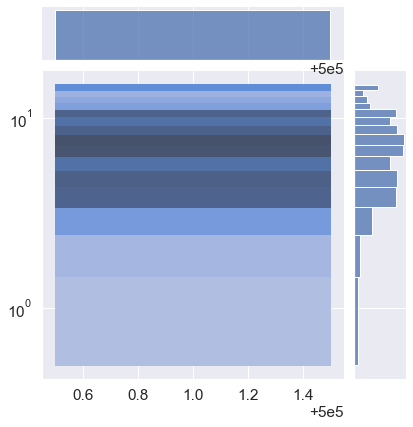

In [ ]:
df_value = df.loc[df['median_house_value'] > 500000, 'median_house_value'].values
df_income = df.loc[df['median_house_value'] > 500000, 'median_income'].values
sns.jointplot(df_value, df_income, kind='hist')
plt.yscale('log')
plt.show()

In [ ]:
max_house_value = np.quantile(df['median_house_value'], q=0.95)
min_house_value = np.quantile(df['median_house_value'], q=0.75)
bottom_threshold = df.loc[(df['median_house_value'] < max_house_value) & 
                          (df['median_house_value'] > min_house_value), 'median_house_value'].median()
df.loc[df['median_house_value'] > 500000, 'median_house_value'] = np.random.uniform(low=bottom_threshold, 
                                                                                   high=500000, 
                                                                                    size=(len(df[df['median_house_value'] > 500000])))
# разницы большой нет, но решил заменить похожими значениями
#df = df[df['median_house_value'] <= 500000].reset_index()

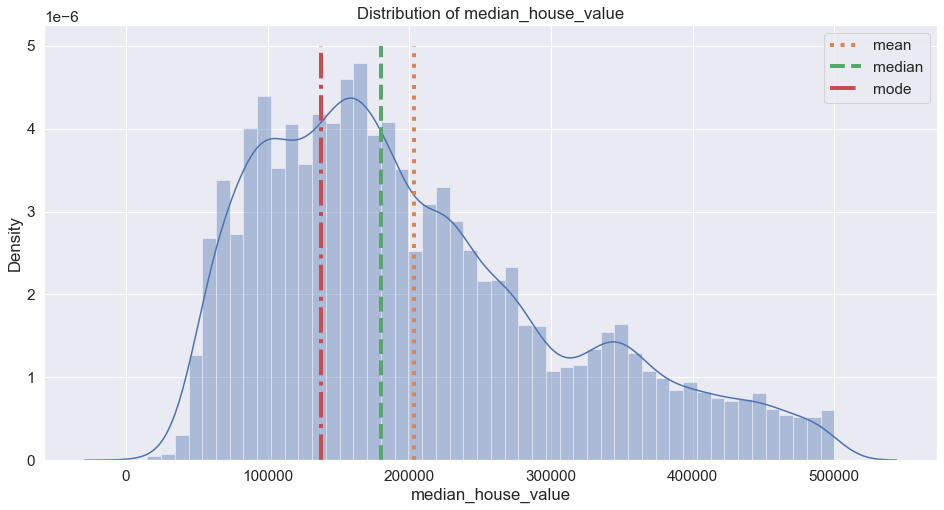

In [ ]:
target_mean = round(df['median_house_value'].mean(), 2)
target_median = df['median_house_value'].median()
target_mode = df['median_house_value'].mode()[0]

plt.figure(figsize = (16, 8))

sns.distplot(df['median_house_value'], bins=50)

y = np.linspace(0, 0.000005, 10)
plt.plot([target_mean] * 10, y, label='mean', linestyle=':', linewidth=4)
plt.plot([target_median] * 10, y, label='median', linestyle='--', linewidth=4)
plt.plot([target_mode] * 10, y, label='mode', linestyle='-.', linewidth=4)

plt.title('Distribution of median_house_value')
plt.legend()
plt.show()

In [ ]:
df['total_bedrooms'].describe()

count    20433.000000
mean       537.870544
std        421.385071
min          1.000000
25%        296.000000
50%        435.000000
75%        647.000000
max       6445.000000
Name: total_bedrooms, dtype: float64

In [ ]:
df.loc[df['total_bedrooms'] > 6000, 'total_bedrooms'] = df['total_bedrooms'].median()
df['total_bedrooms'].describe()

count    20433.000000
mean       537.293762
std        417.472900
min          1.000000
25%        296.000000
50%        435.000000
75%        647.000000
max       5471.000000
Name: total_bedrooms, dtype: float64

In [ ]:
df['population'].describe()

count    20041.000000
mean      1425.418213
std       1135.185791
min          3.000000
25%        786.000000
50%       1165.000000
75%       1726.000000
max      35682.000000
Name: population, dtype: float64

In [ ]:
df.loc[df['population'] > 20000, 'population'] = df['population'].median()
df['population'].describe()

count    20041.000000
mean      1422.328735
std       1092.395752
min          3.000000
25%        786.000000
50%       1165.000000
75%       1726.000000
max      16305.000000
Name: population, dtype: float64

In [ ]:
df.loc[df['longitude'] > 0, 'longitude'] = df.loc[df['longitude'] > 0, 'longitude'] * -1
df.loc[df['longitude'] == 0, 'longitude'] = df['longitude'].median()
df.loc[(df['latitude'] <= 0) | (df['latitude'] > 50), 'latitude'] = df['latitude'].median()

In [ ]:
df['housing_median_age'] = df['housing_median_age'].fillna(df['housing_median_age'].median())
df['total_bedrooms'] = df['total_bedrooms'].fillna(df['total_bedrooms'].median())
df['population'] = df['population'].fillna(df['population'].median())
df.isnull().sum()

longitude             0
latitude              0
housing_median_age    0
total_rooms           0
total_bedrooms        0
population            0
households            0
median_income         0
median_house_value    0
ocean_proximity       0
dtype: int64

In [ ]:
df = pd.concat([df, pd.get_dummies(df['ocean_proximity'])], axis=1)
df['lonlat'] = df['latitude'] + df['longitude']
df['bedroom_share'] = df['total_bedrooms'] / df['total_rooms'] * 100
df['population_per_room'] = df['population'] / df['total_rooms']

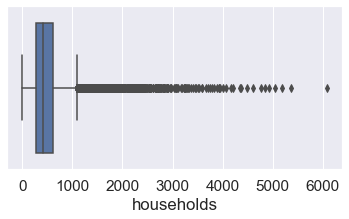

In [ ]:
plt.figure(figsize=(6, 3))

sns.boxplot(df['households'], whis=1.5)

plt.xlabel('households')
plt.show()

In [ ]:
df.loc[df['households'] > 6000, 'households'] = df['households'].median()

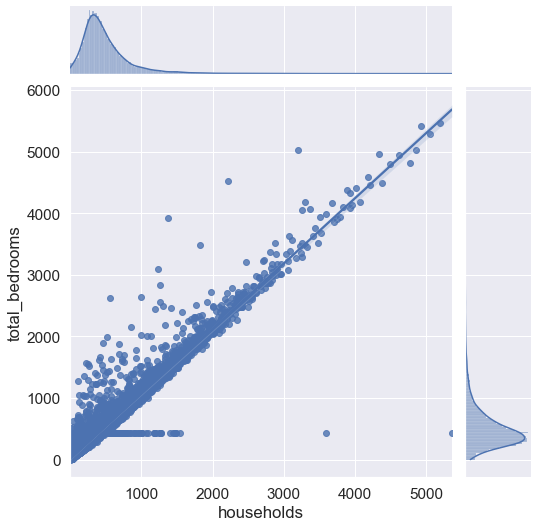

In [ ]:
grid = sns.jointplot(df['households'], df['total_bedrooms'], kind='reg')
grid.fig.set_figwidth(8)
grid.fig.set_figheight(8)

plt.show()

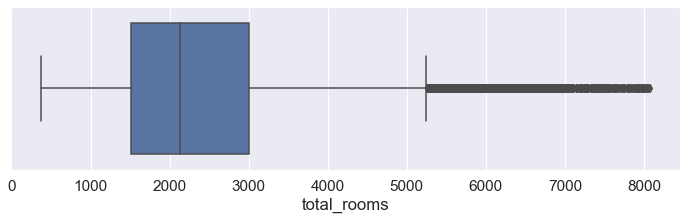

In [ ]:
plt.figure(figsize=(12, 3))

sns.boxplot(df['total_rooms'], whis=1.5)

plt.xlabel('total_rooms')
plt.show()

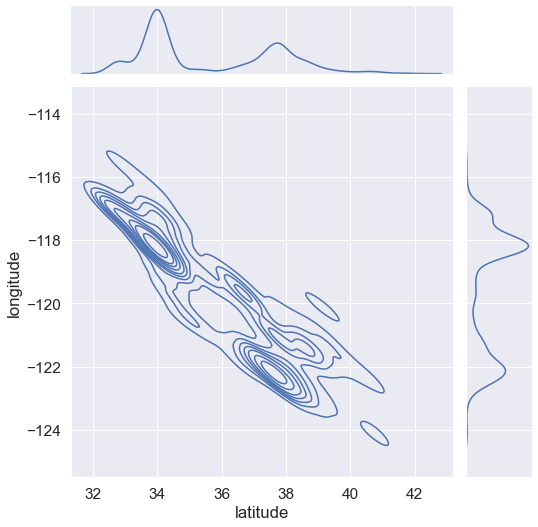

In [ ]:
grid = sns.jointplot(df['latitude'], df['longitude'], kind='kde')
grid.fig.set_figwidth(8)
grid.fig.set_figheight(8)

plt.show()

In [ ]:
df['city'] = (df['longitude'] > -120) * 1

In [ ]:
df['city'] = df['city'].astype(np.int8)

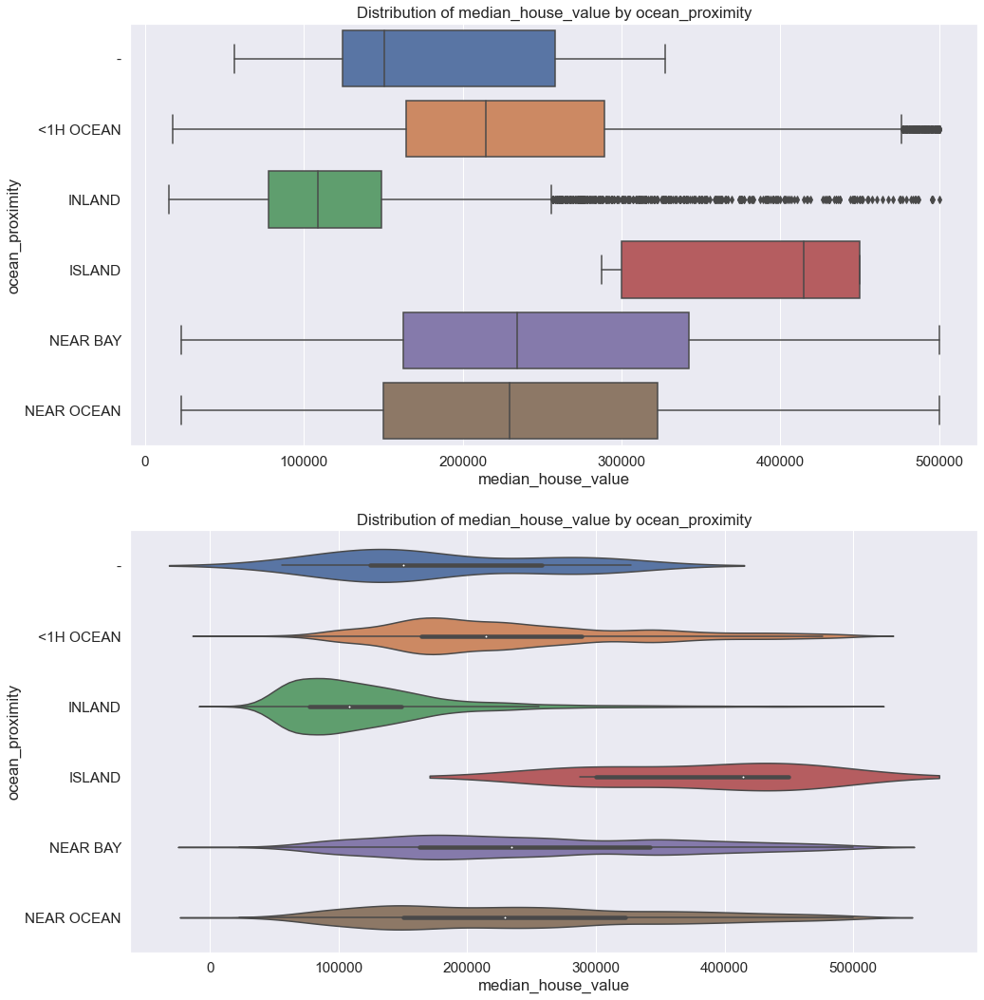

In [ ]:
plt.figure(figsize=(16, 18))
plt.subplot(2, 1, 1)
sns.boxplot(df['median_house_value'], df['ocean_proximity'], whis=1.5)

plt.xlabel('median_house_value')
plt.ylabel('ocean_proximity')
plt.title('Distribution of median_house_value by ocean_proximity')

plt.subplot(2, 1, 2)
sns.violinplot(df['median_house_value'], df['ocean_proximity'])

plt.xlabel('median_house_value')
plt.ylabel('ocean_proximity')
plt.title('Distribution of median_house_value by ocean_proximity')
plt.show()

In [ ]:
df.loc[df['ocean_proximity'] == '-', 'ocean_proximity'].value_counts()

-             23
<1H OCEAN      0
INLAND         0
ISLAND         0
NEAR BAY       0
NEAR OCEAN     0
Name: ocean_proximity, dtype: int64

In [ ]:
df = df.rename(columns={'-': 'unknown district'})

In [ ]:
df['median_income'].value_counts()

3.1250     49
15.0001    49
2.8750     46
2.6250     44
4.1250     44
           ..
5.7260      1
4.0648      1
3.2633      1
2.9567      1
6.2895      1
Name: median_income, Length: 12928, dtype: int64

In [ ]:
max_income = np.quantile(df['median_income'], q=0.985)
min_income = np.quantile(df['median_income'], q=0.885)
bottom_threshold = df.loc[(df['median_income'] < max_income) & 
                          (df['median_income'] > min_income), 'median_income'].median()
df.loc[df['median_income'] == 15.0001, 'median_income'] = np.random.uniform(low=bottom_threshold, 
                                                                                   high=14.99, 
                                                                                    size=(len(df[df['median_income'] == 15.0001])))

In [ ]:
df['median_income'].describe()

count    20640.000000
mean         3.860977
std          1.855953
min          0.499900
25%          2.563400
50%          3.534800
75%          4.743250
max         15.000000
Name: median_income, dtype: float64

In [ ]:
df['population'].describe()

count    20640.000000
mean      1414.860718
std       1077.293213
min          3.000000
25%        797.000000
50%       1165.000000
75%       1701.000000
max      16305.000000
Name: population, dtype: float64

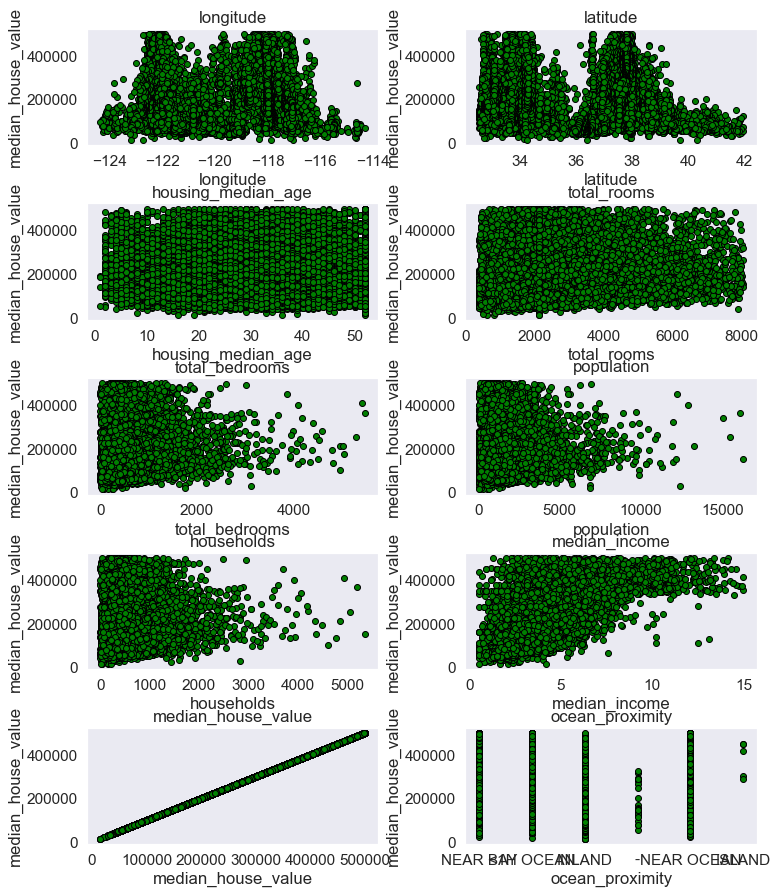

In [ ]:
fig, ax = plt.subplots(nrows=5, ncols=2, figsize=(12, 15))
ax = ax.flatten()
for idx, axe in enumerate(ax):
    axe.scatter(df.iloc[:, idx].values, df['median_house_value'].values, color='green', ec='black')
    axe.set_title(f'{df.columns[idx]}')
    axe.set_xlabel(f'{df.columns[idx]}')
    axe.set_ylabel('median_house_value')
    axe.grid(alpha=0.3)
plt.subplots_adjust(wspace=0.3, hspace=0.5)
plt.show()

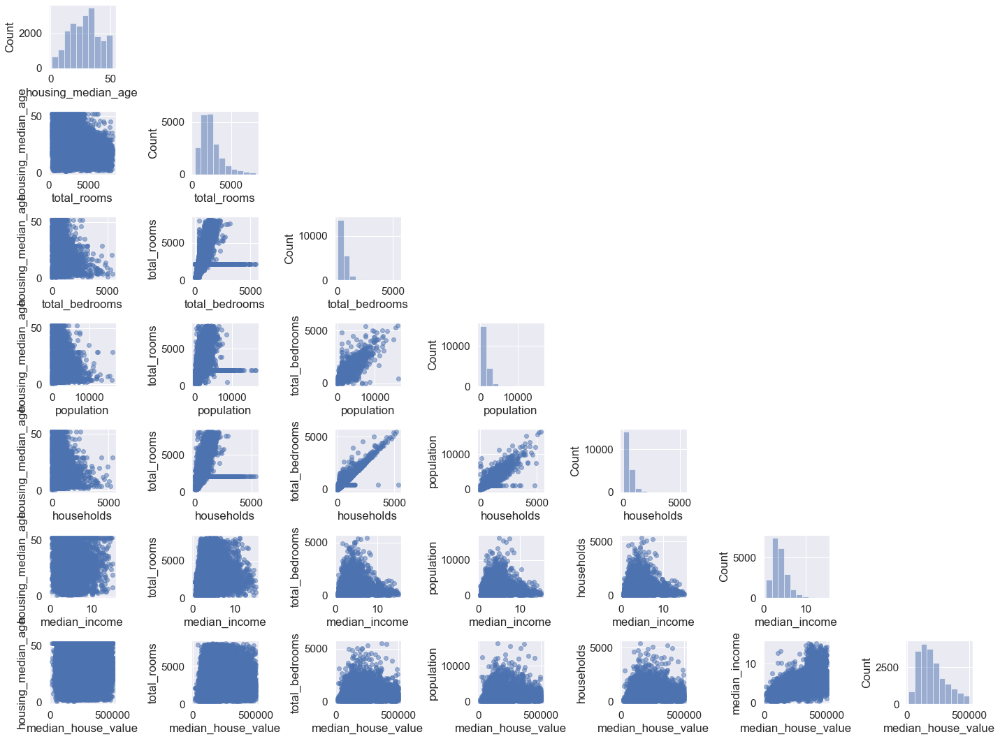

In [ ]:
spx(df[df.columns[2:9]].values, figsize=(20, 15), names=df.columns[2:9], alpha=0.5)
plt.tight_layout()
plt.show()

In [ ]:
df.groupby('ocean_proximity').agg({'median_house_value': ['mean', 'median', 'count']})

median_house_value                
                              mean    median count
ocean_proximity                                   
-                    177352.171875  150600.0    23
<1H OCEAN            235200.859375  214800.0  9127
INLAND               124471.929688  108500.0  6542
ISLAND               380440.000000  414700.0     5
NEAR BAY             252165.234375  234050.0  2288
NEAR OCEAN           242816.718750  229500.0  2655

In [ ]:
df.drop('ocean_proximity', axis=1, inplace=True)

In [ ]:
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,unknown district,<1H OCEAN,INLAND,ISLAND,NEAR BAY,NEAR OCEAN,lonlat,bedroom_share,population_per_room,city
0,-122.230003,37.880001,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,0,0,0,0,1,0,-84.350006,14.659090,0.365909,0
1,-122.220001,37.860001,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,0,0,0,0,1,0,-84.360001,15.579659,0.338217,0
2,-122.239998,37.849998,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,0,0,0,0,1,0,-84.389999,12.951602,0.338105,0
3,-122.250000,37.849998,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,0,0,0,0,1,0,-84.400002,18.445841,0.437991,0
4,-122.250000,37.849998,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,0,0,0,0,1,0,-84.400002,17.209587,0.347265,0


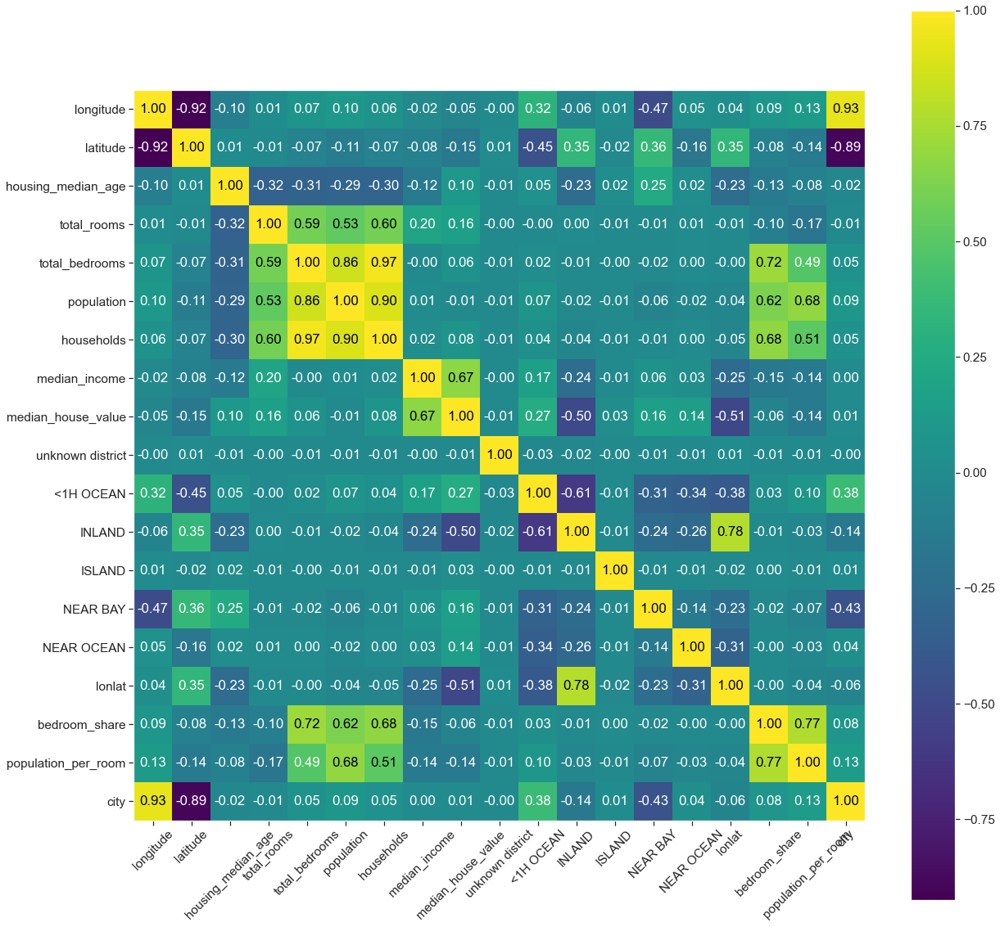

In [ ]:
cm = np.corrcoef(df.values.T)
hm = heatmap(cm, row_names=df.columns, column_names=df.columns, figsize=(20,20))
plt.show()

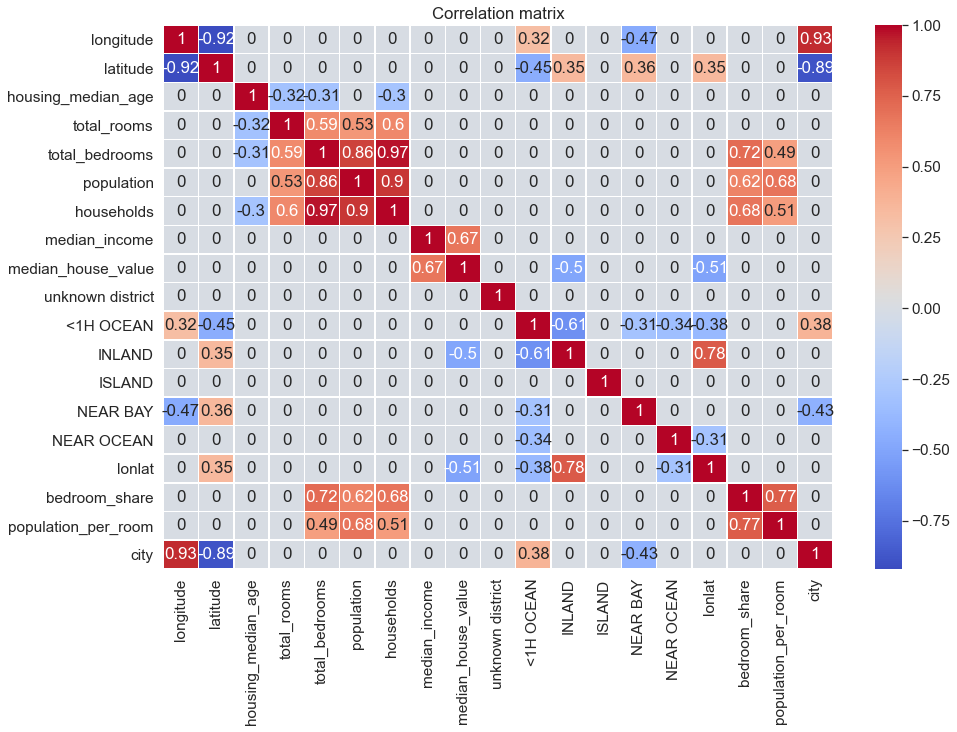

In [ ]:
plt.figure(figsize = (15,10))

sns.set(font_scale=1.4)

corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix, 2)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0

sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm')

plt.title('Correlation matrix')
plt.show()

In [ ]:
cols = list(df.columns[:8]) + list(df.columns[9:]) + [df.columns[8]]
df = df[[*cols]]
df.head(1)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,unknown district,<1H OCEAN,INLAND,ISLAND,NEAR BAY,NEAR OCEAN,lonlat,bedroom_share,population_per_room,city,median_house_value
0,-122.230003,37.880001,41.0,880.0,129.0,322.0,126.0,8.3252,0,0,0,0,1,0,-84.350006,14.65909,0.365909,0,452600.0


In [ ]:
# вспомогательный индусский код) две похожие функции, возвращают датафрейм с признаками с наивысшей коррелицией с целевой
# переменной, при значении didc=True, идет удаление признаков, у которых наибольшая корреляция между собой
from collections import deque

def select_features(df, threshold=0.7, min_features=5, target='median_house_value', disc=True):
    cm = np.corrcoef(df.values.T)
    cm_indices = np.triu_indices(df.columns.values.shape[0], 1)
    dict_ = {(df.columns[idx], df.columns[jdx]): abs(cm[idx, jdx]) for idx, jdx in zip(*cm_indices)}
    result, counter = set(), threshold
    while counter > 0.1:
        if len(result) >= min_features:
            break
        for k, v in sorted(dict_.items(), key=lambda x: x[1], reverse=True):
            if k[1] == target and v >= counter:
                result.add(k[0]) if k[0] != target else result.add(k[1])
        counter -= 0.1
    if disc:
        for k in dict_.keys():
            if k[1] != target and ((k[0] in result) and (k[1] in result)) \
            and (dict_.get((k[0], k[1])) >= threshold):
                try:
                    result.discard(k[0]) if dict_.get((k[0], target)) < dict_.get((k[1], target)) \
                    else result.discard(k[1])
                except TypeError:
                    pass
    final_ = list(result)
    selected_df = df[[*final_, target]]
    return selected_df

def select_corr_feature(df, threshold=0.5, target='median_house_value', disc=True):
    X_corr = df.corr()
    X_corr_sel = X_corr.drop(target, axis=0)[target]
    high_corr = [x for x, y in zip(X_corr_sel.index, X_corr_sel) if np.abs(y) > threshold]
    if disc:
        stack, high_, removed = deque(high_corr), set(), set()
        while len(stack) > 1:
            x = stack.popleft()
            for y in stack.copy():
                if np.abs(X_corr.loc[x, y]) >= threshold:
                    if np.abs(X_corr.loc[x, target]) > np.abs(X_corr.loc[y, target]):
                        high_.add(x)
                        if y in stack:
                            stack.remove(y)
                        high_.discard(y)
                        removed.add(y)
                    else:
                        high_.add(y)
                        if x in stack:
                            stack.remove(x)
                        high_.discard(x)
                        removed.add(x)
                else:
                    if x not in removed:
                        high_.add(x)
        high_corr = list(high_)
    return df[[*high_corr, target]]

In [ ]:
def get_important_features(estimator, X, y):
    scaler = StandardScaler()
    scaler_y = StandardScaler()
    X_std = scaler.fit_transform(X)
    y_std = scaler_y.fit_transform(y.reshape(-1, 1)).reshape(-1)
    estimator.fit(X_std, y_std)
    important_features = [feature for feature, weight in zip(list(df.columns), estimator.coef_.flatten())
                         if np.abs(weight) > 0.5]
    return important_features

In [ ]:
def evaluate_preds(true_values, pred_values, save=False):
    """Оценка качества модели и график preds vs true"""
    
    print("R2:\t" + str(round(r2_score(true_values, pred_values), 3)) + "\n" +
          "RMSE:\t" + str(round(np.sqrt(mse(true_values, pred_values)), 3)) + "\n" +
          "MSE:\t" + str(round(mse(true_values, pred_values), 3)) + "\n" +
          "MSE_scaled:\t" + str(round(mse(true_values, pred_values) / np.median(true_values), 3))
         )
    
    plt.figure(figsize=(8,8))
    
    sns.scatterplot(x=pred_values, y=true_values)
    plt.plot([0, 500000], [0, 500000], linestyle='--', color='red')
    
    plt.xlabel('Predicted values')
    plt.ylabel('True values')
    plt.title('True vs Predicted values')
    
    if save:
        if not os.path.exists('./saved'):
            os.makedirs('./saved')
        plt.savefig('./saved' + 'report.png')
    plt.show()

In [ ]:
X, y = df.iloc[:, :-1].values, df.iloc[:, -1].values
llr = LinearRegression()
df_important = df[get_important_features(llr, X, y)]

In [ ]:
list(df_important.columns)

['longitude',
 'latitude',
 'median_income',
 '<1H OCEAN',
 'INLAND',
 'NEAR BAY',
 'NEAR OCEAN',
 'lonlat']

In [ ]:
# скорее всего такой набор не будет иметь успеха
X_imp, y_imp = df[list(df_important.columns)].values, df.iloc[:, -1].values
scaler = StandardScaler()
scaler_y = StandardScaler()
X_imp_std = scaler.fit_transform(X_imp)
y_imp_std = scaler_y.fit_transform(y_imp.reshape(-1, 1)).reshape(-1)
llr.fit(X_imp_std, y_imp_std)
y_imp_pred = llr.predict(X_imp_std)
r2_score(y_imp_std, y_imp_pred)

0.5917027739884011

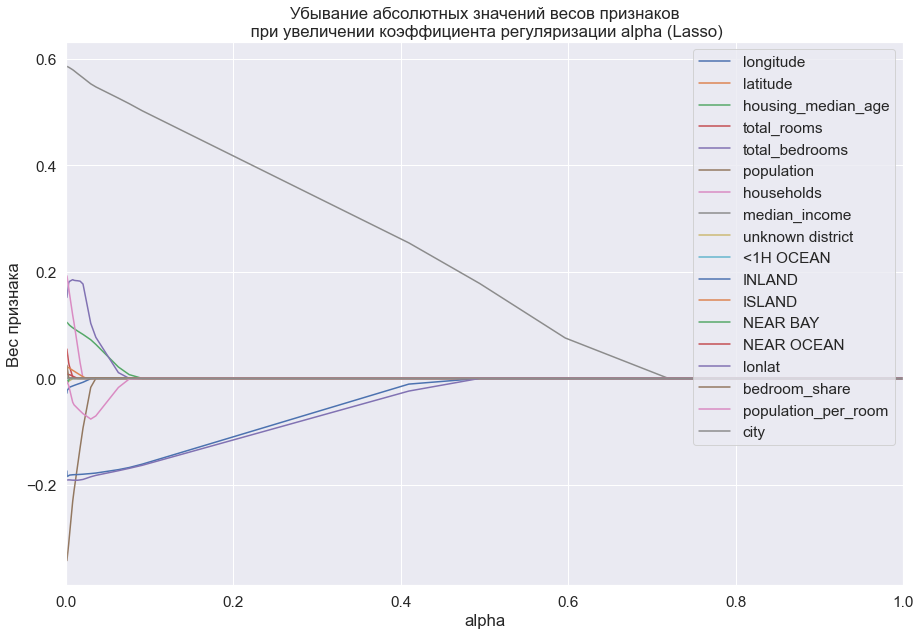

In [ ]:
n = 50
len_features = len(list(df.columns)) - 1
coeffs = np.zeros((n, len_features))
sc_x, sc_y = StandardScaler(), StandardScaler()
X_all_std, y_all_std = sc_x.fit_transform(X), sc_y.fit_transform(y[:, np.newaxis]).flatten()
X_scaled = pd.DataFrame(X_all_std, columns=list(df.columns)[:-1])
alpha_list = np.logspace(-3, 1, n)

for i, val in enumerate(alpha_list):
    lasso = Lasso(alpha=val)
    lasso.fit(X_scaled, y_all_std)
    
    coeffs[i, :] = lasso.coef_.flatten()
plt.figure(figsize=(15, 10))
for i in range(len_features):
    plt.plot(alpha_list, coeffs[:, i])

plt.title('Убывание абсолютных значений весов признаков\n при увеличении коэффициента регуляризации alpha (Lasso)')

plt.xlabel('alpha')
plt.ylabel('Вес признака')
plt.xlim([0.0, 1.0])
plt.legend(list(df.columns))
plt.show()

из всего вышеприведенного следует, что признаки lonlat, median_income и INLAND имеют высокое значение для будущей модели, так как убывают медленнее

In [ ]:
df_selected = select_features(df, min_features=8, threshold=0.7, disc=False)
list(df_selected.columns)
# слабейшая корреляция - данный набор попробуем использовать лишь для сравнения на начальном этапе

['<1H OCEAN',
 'latitude',
 'lonlat',
 'NEAR BAY',
 'total_rooms',
 'population_per_room',
 'NEAR OCEAN',
 'INLAND',
 'median_income',
 'median_house_value']

In [ ]:
df_selected2 = select_corr_feature(df, threshold=0.1, disc=True)
list(df_selected2.columns)

['latitude', 'NEAR BAY', 'median_income', 'median_house_value']

1) median_income	0.43099504001264566
2) lonlat	0.2404379126168149
3) population_per_room	0.09411341523517734
4) latitude	0.05939945225105015
5) longitude	0.05250297623208161
6) bedroom_share	0.036309178836763475
7) housing_median_age	0.030685902350181725
8) households	0.012945128929079761
9) population	0.012814305280248241
10) total_bedrooms	0.012119854195624431
11) total_rooms	0.010791767529077163
12) <1H OCEAN	0.0031049548053284416
13) NEAR OCEAN	0.0013926405082502152
14) INLAND	0.0009298177308733708
15) NEAR BAY	0.0008329497897018359
16) city	0.0005478843992096831
17) ISLAND	5.26655908364804e-05
18) unknown district	2.4153707055541934e-05


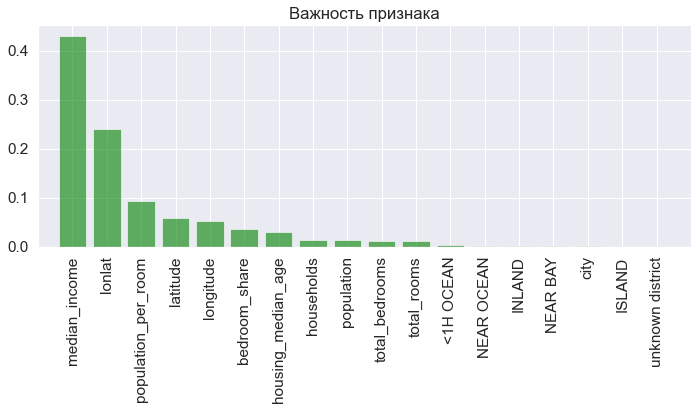

In [ ]:
# воспользуемся еще одним способом - через атрибут важности в случайном лесе
feat_labels = df.columns[:-1]
X, y = df.iloc[:, :-1], df.iloc[:, -1]
forest_cl = RFR(n_estimators=500, random_state=1)
forest_cl.fit(X, y)
importances = forest_cl.feature_importances_
indices = np.argsort(importances)[::-1]
for x in range(X.shape[1]):
    print(f'{x+1}) {feat_labels[indices[x]]}\t{importances[indices[x]]}')
plt.figure(figsize=(10, 6))
plt.title('Важность признака')
plt.bar(range(X.shape[1]), importances[indices], align='center', alpha=0.6, color='green')
plt.xticks(range(X.shape[1]), feat_labels[indices], rotation=90)
plt.xlim([-1, X.shape[1]])
plt.tight_layout()
plt.show()

In [ ]:
X_forest = df[['median_income', 'lonlat', 'population_per_room', 'latitude', 'longitude', 'bedroom_share',
              'housing_median_age', 'households']].values

In [ ]:
class ChooseBestSubset:
    def __init__(self, estimator, k_features, scoring='r2_score', test_size=0.25, random_state=1):
        self.scoring = str(scoring)
        self.estimator = clone(estimator)
        self.k_features = k_features
        self.test_size = test_size
        self.random_state = random_state
        if (self.scoring == 'r2_score') or (self.scoring == 'mse'):
            self.scoring = eval(self.scoring)
        else:
            raise ValueError(f'The scoring has to be "r2_score" or "mse", given: {self.scoring}')
    def fit(self, X, y):
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=self.test_size, 
                                                           random_state=self.random_state)
        dim = X_train.shape[1]
        self.indices_ = tuple(range(dim))
        self.subsets_ = [self.indices_]
        score = self._calc_score(X_train, y_train, X_test, y_test, self.indices_)
        self.scores_ = [score]
        while dim > self.k_features:
            scores, subsets = [], []
            for p in combinations(self.indices_, r=dim-1):
                score = self._calc_score(X_train, y_train, X_test, y_test, p)
                scores.append(score)
                subsets.append(p)
            best = np.argmax(scores) if self.scoring == r2_score else np.argmin(scores)
            self.indices_ = subsets[best]
            self.subsets_.append(self.indices_)
            dim -= 1
            self.scores_.append(scores[best])
        self.k_score_ = self.scores_[-1]
        return self
    def _calc_score(self, X_train, y_train, X_test, y_test, indices):
        sc_x, sc_y = StandardScaler(), StandardScaler()
        X_train_std, y_train_std = sc_x.fit_transform(X_train), sc_y.fit_transform(y_train[:, np.newaxis]).flatten()
        X_test_std, y_test_std = sc_x.transform(X_test), sc_y.transform(y_test[:, np.newaxis]).flatten()
        self.estimator.fit(X_train_std[:, indices], y_train_std)
        y_pred = self.estimator.predict(X_test_std[:, indices])
        score = self.scoring(y_test_std, y_pred)
        return score

In [ ]:
alr = LinearRegression()

In [ ]:
X, y = df.iloc[:, :-1].values, df.iloc[:, -1].values

In [ ]:
selector = ChooseBestSubset(alr, k_features=1)
selector2 = ChooseBestSubset(alr, k_features=1, scoring='mse')
selector.fit(X, y)
selector2.fit(X, y)

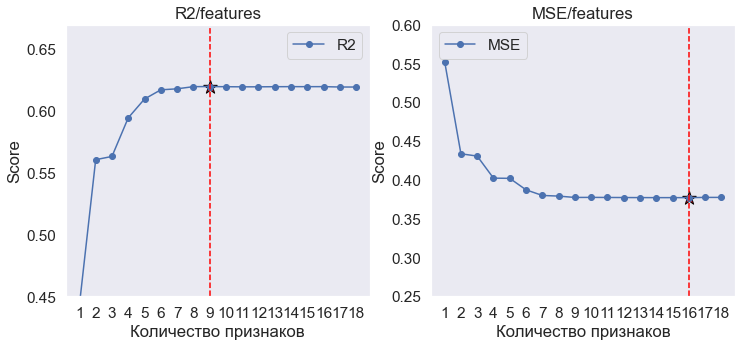

In [ ]:
k_feat = [len(k) for k in selector.subsets_]
k_feat2 = [len(k) for k in selector2.subsets_]
fig, ax = plt.subplots(1, 2, figsize=(12, 5))
ax[0].plot(k_feat, selector.scores_, marker='o', label='R2')
ax[0].scatter(k_feat[np.argmax(np.array(selector.scores_))], max(selector.scores_), marker='*', color='red', 
              ec='black', s=200)
ax[0].axvline(k_feat[np.argmax(np.array(selector.scores_))], color='red', linestyle='--')
ax[0].set_ylim([0.45, 0.67])
ax[0].set_title('R2/features')
ax[0].set_ylabel('Score')
ax[0].set_xlabel('Количество признаков')
ax[0].legend(loc='best')
ax[0].set_xticks(k_feat)
ax[0].grid(color='orange', alpha=0.3)
ax[1].plot(k_feat, selector2.scores_, marker='o', label='MSE')
ax[1].scatter(k_feat2[np.argmin(np.array(selector2.scores_))], min(selector2.scores_), marker='*', color='red', 
              ec='black', s=200)
ax[1].axvline(k_feat[np.argmin(np.array(selector2.scores_))], color='red', linestyle='--')
ax[1].set_ylim([0.25, 0.6])
ax[1].set_title('MSE/features')
ax[1].legend(loc='best')
ax[1].set_ylabel('Score')
ax[1].set_xlabel('Количество признаков')
ax[1].set_xticks(k_feat2)
ax[1].grid(color='orange', alpha=0.3)
plt.show()

In [ ]:
selector.subsets_[np.argmax(np.array(selector.scores_))], selector2.subsets_[np.argmin(np.array(selector2.scores_))]

((2, 3, 4, 5, 6, 7, 10, 14, 15),
 (0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 13, 14, 15, 16, 17))

In [ ]:
indexes = selector2.subsets_[np.argmin(np.array(selector2.scores_))]
X_selected_cbs = df.values[:, indexes]
X_selected = df_selected.iloc[:, :-1].values
X_selected_cbs.shape, X_selected.shape, X.shape

((20640, 16), (20640, 9), (20640, 18))

In [ ]:
selector.subsets_[np.argmax(np.array(selector.scores_))]

(2, 3, 4, 5, 6, 7, 10, 14, 15)

In [ ]:
cols = [df.columns[i] for i in selector2.subsets_[np.argmin(np.array(selector2.scores_))]]
cols += ['median_house_value']
df_selected_cbs = df[[*cols]]
df_selected_cbs.head(1)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,<1H OCEAN,INLAND,ISLAND,NEAR OCEAN,lonlat,bedroom_share,population_per_room,city,median_house_value
0,-122.230003,37.880001,41.0,880.0,129.0,322.0,126.0,8.3252,0,0,0,0,-84.350006,14.65909,0.365909,0,452600.0


In [ ]:
list(df_selected_cbs.columns)

['longitude',
 'latitude',
 'housing_median_age',
 'total_rooms',
 'total_bedrooms',
 'population',
 'households',
 'median_income',
 '<1H OCEAN',
 'INLAND',
 'ISLAND',
 'NEAR OCEAN',
 'lonlat',
 'bedroom_share',
 'population_per_room',
 'city',
 'median_house_value']

In [ ]:
class CustomLinearRegression:
    def __init__(self, eta=0.001, epochs=20, l2=0., seed=None):
        self.eta = eta
        self.epochs = epochs
        self.random = np.random.RandomState(seed)
        self.l2 = l2
    def fit(self, X, y):
        self.weights = self.random.normal(loc=0.0, scale=0.01,
                                      size=(1 + X.shape[1]))
        self.losses = []
        for _ in range(self.epochs):
            output = self.input_(X)
            errors = (output - y)
            grad = (X.T.dot(errors) + self.l2 * self.weights[1:])
            self.weights[1:] -= self.eta * grad
            self.weights[0] -= self.eta * errors.sum()
            l2_term = self.l2 * np.sum(self.weights[1:]**2)
            loss = (errors**2).sum() / 2.0 + l2_term
            self.losses.append(loss)
        return self
    def input_(self, X):
        return np.dot(X, self.weights[1:]) + self.weights[0]
    def predict(self, X):
        return self.input_(X)

In [ ]:
df_selected.head(1)

,<1H OCEAN,latitude,lonlat,NEAR BAY,total_rooms,population_per_room,NEAR OCEAN,INLAND,median_income,median_house_value
0,0,37.880001,-84.350006,1,880.0,0.365909,0,0,8.3252,452600.0


In [ ]:
print('Features: ', *df_selected.columns.values[:-1], sep=' / ')
features = df_selected.values
split_ = int(0.91 * features.shape[0])
indices = np.arange(features.shape[0])
np.random.shuffle(indices)
train_ind, test_ind = indices[:split_], indices[split_:]
X_train, X_test = features[train_ind, :-1], features[test_ind, :-1]
y_train, y_test = features[train_ind, -1], features[test_ind, -1]
sc_x, sc_y = StandardScaler(), StandardScaler()
X_train_std, y_train_std = sc_x.fit_transform(X_train), sc_y.fit_transform(y_train.reshape(-1, 1)).reshape(-1)
X_test_std, y_test_std = sc_x.transform(X_test), sc_y.transform(y_test.reshape(-1, 1)).reshape(-1)
lr = CustomLinearRegression(seed=1, epochs=50, eta=0.000005, l2=0.0001) 
lr.fit(X_train_std, y_train)
y_train_pred = lr.predict(X_train_std)
y_test_pred = lr.predict(X_test_std)
print('MSE при обучении: %.3f, при испытании: %.3f' % (mse(y_train, y_train_pred), 
                                                       mse(y_test, y_test_pred)))
print('R^2 при обучении: %.3f, при испытании: %.3f' % (r2_score(y_train, y_train_pred), 
                                                    r2_score(y_test, y_test_pred)))

Features:  / <1H OCEAN / latitude / lonlat / NEAR BAY / total_rooms / population_per_room / NEAR OCEAN / INLAND / median_income
MSE при обучении: 4633209127.696, при испытании: 4337684749.195
R^2 при обучении: 0.595, при испытании: 0.623


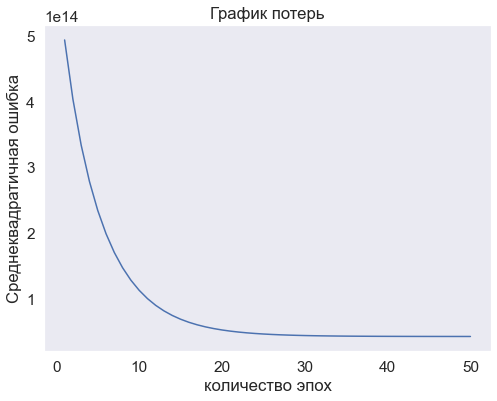

In [ ]:
def plot_losses(clf):
    plt.figure(figsize=(8,6))
    plt.plot(range(1, clf.epochs + 1), clf.losses)
    plt.ylabel('Среднеквадратичная ошибка')
    plt.xlabel('количество эпох')
    plt.title('График потерь')
    plt.grid(alpha=0.3, color='orange')
    plt.show()
plot_losses(lr)

In [ ]:
r2_dict = {}

In [ ]:
print('Features: ', *df_selected_cbs.columns.values[:-1], sep=' / ')
features = df_selected_cbs.values
split_ = int(0.91 * features.shape[0])
indices = np.arange(features.shape[0])
#np.random.shuffle(indices)
train_ind, test_ind = indices[:split_], indices[split_:]
X_train, X_test = features[train_ind, :-1], features[test_ind, :-1]
y_train, y_test = features[train_ind, -1], features[test_ind, -1]
X_train_std, y_train_std = sc_x.fit_transform(X_train), sc_y.fit_transform(y_train.reshape(-1, 1)).reshape(-1)
X_test_std, y_test_std = sc_x.transform(X_test), sc_y.transform(y_test.reshape(-1, 1)).reshape(-1)
lr = CustomLinearRegression(seed=1, epochs=100, eta=0.00001, l2=0.001) 
lr.fit(X_train_std, y_train_std)
y_train_pred = lr.predict(X_train_std)
y_test_pred = lr.predict(X_test_std)
print('MSE при обучении: %.3f, при испытании: %.3f' % (mse(y_train_std, y_train_pred), 
                                                       mse(y_test_std, y_test_pred)))
print('R^2 при обучении: %.3f, при испытании: %.3f' % (r2_score(y_train_std, y_train_pred), 
                                                       r2_score(y_test_std, y_test_pred)))

Features:  / longitude / latitude / housing_median_age / total_rooms / total_bedrooms / population / households / median_income / <1H OCEAN / INLAND / ISLAND / NEAR OCEAN / lonlat / bedroom_share / population_per_room / city
MSE при обучении: 0.377, при испытании: 0.225
R^2 при обучении: 0.623, при испытании: 0.630


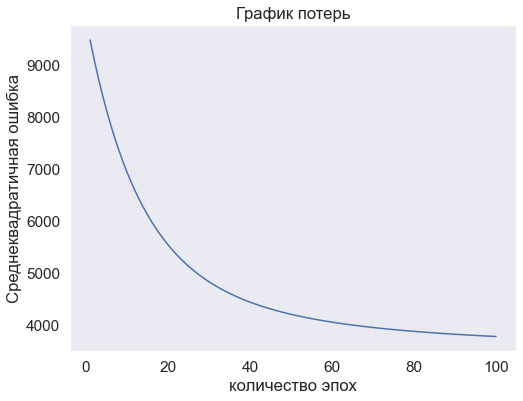

In [ ]:
plot_losses(lr)

In [ ]:
print('Features: ', *df.columns.values[:-1], sep=' / ')
features = df.values
split_ = int(0.91 * features.shape[0])
indices = np.arange(features.shape[0])
#np.random.shuffle(indices)
train_ind, test_ind = indices[:split_], indices[split_:]
X_train, X_test = features[train_ind, :-1], features[test_ind, :-1]
y_train, y_test = features[train_ind, -1], features[test_ind, -1]
X_train_std, y_train_std = sc_x.fit_transform(X_train), sc_y.fit_transform(y_train.reshape(-1, 1)).reshape(-1)
X_test_std, y_test_std = sc_x.transform(X_test), sc_y.transform(y_test.reshape(-1, 1)).reshape(-1)
lr = CustomLinearRegression(seed=1, epochs=100, eta=0.00001, l2=0.1) 
lr.fit(X_train_std, y_train_std)
y_train_pred = lr.predict(X_train_std)
y_test_pred = lr.predict(X_test_std)
print('MSE при обучении: %.3f, при испытании: %.3f' % (mse(y_train_std, y_train_pred), 
                                                       mse(y_test_std, y_test_pred)))
print('R^2 при обучении: %.3f, при испытании: %.3f' % (r2_score(y_train_std, y_train_pred), 
                                                       r2_score(y_test_std, y_test_pred)))
r2_dict.update({lr.__class__.__name__: [r2_score(y_train_std, y_train_pred), r2_score(y_test_std, y_test_pred)]})

Features:  / longitude / latitude / housing_median_age / total_rooms / total_bedrooms / population / households / median_income / unknown district / <1H OCEAN / INLAND / ISLAND / NEAR BAY / NEAR OCEAN / lonlat / bedroom_share / population_per_room / city
MSE при обучении: 0.377, при испытании: 0.226
R^2 при обучении: 0.623, при испытании: 0.630


In [ ]:
pd.DataFrame([y_test, sc_y.inverse_transform(y_test_pred)]).transpose().head(15)

,0,1
0,101600.0,96325.295401
1,66100.0,72407.014679
2,74800.0,62830.503200
3,85400.0,96335.000332
4,76400.0,79026.583943
5,97700.0,67339.011848
6,105700.0,82182.426693
7,98500.0,98019.220388
8,76500.0,83392.633207
9,74500.0,47571.345141


In [ ]:
def print_scores(y_train, y_train_pred, y_test, y_test_pred):
    print('MSE при обучении: %.3f, при испытании: %.3f' % (mse(y_train, y_train_pred), 
                                                       mse(y_test, y_test_pred)))
    print('R^2 при обучении: %.3f, при испытании: %.3f' % (r2_score(y_train, y_train_pred), 
                                                       r2_score(y_test, y_test_pred)))

In [ ]:
# без испытаткльного набора
alr.fit(X_train, y_train)
y_train_pred = alr.predict(X_train)
y_test_pred = alr.predict(X_test)
print_scores(y_train, y_train_pred, y_test, y_test_pred)

MSE при обучении: 4371792896.000, при испытании: 2648786944.000
R^2 при обучении: 0.624, при испытании: 0.626


In [ ]:
def cross_score(X, y, clf, num_splits=None, scoring='neg_mean_squared_error'):
    if num_splits is None:
        loo = LeaveOneOut()
        num_splits = loo.get_n_splits(X)
    scores = cross_val_score(estimator=clf, X=X, y=y, scoring=scoring, cv=num_splits, n_jobs=-1)
    print(f'Accuracy on cross_validation: {np.mean(scores)} +/- {np.std(scores)}')
    return scores

In [ ]:
linear_regr = LinearRegression()
cross_score(X, y, linear_regr, num_splits=10, scoring=None)

Accuracy on cross_validation: 0.4825782853122407 +/- 0.10507342797615107


array([0.2729037 , 0.53618898, 0.43743162, 0.44144463, 0.58572458,
       0.58410029, 0.48712159, 0.40204527, 0.42555924, 0.65326296])

In [ ]:
# признаки на основе корреляции
X_selected, y_selected = df_selected.iloc[:, :-1].values, df_selected.iloc[:, -1].values
X_train_sel, X_test_sel, y_train_sel, y_test_sel = train_test_split(X_selected, y_selected, test_size=0.2, shuffle=True,
                                                                    random_state=1)
sc_x, sc_y = StandardScaler(), StandardScaler()
X_train_std_sel, y_train_std_sel = sc_x.fit_transform(X_train_sel), sc_y.fit_transform(y_train_sel.reshape(-1, 1)).reshape(-1)
X_test_std_sel, y_test_std_sel = sc_x.transform(X_test_sel), sc_y.transform(y_test_sel.reshape(-1, 1)).reshape(-1)

In [ ]:
# признаки, выбранные путем анализа поднаборов данных
X_selected_cbs, y_selected_cbs = df_selected_cbs.iloc[:, :-1].values, df_selected_cbs.iloc[:, -1].values
X_train_sel_cbs, X_test_sel_cbs, y_train_sel_cbs, y_test_sel_cbs = train_test_split(X_selected_cbs, y_selected_cbs, shuffle=True,
                                                                                    test_size=0.2, random_state=1)
sc_x, sc_y = StandardScaler(), StandardScaler()
X_train_std_cbs, y_train_std_cbs = sc_x.fit_transform(X_train_sel_cbs), sc_y.fit_transform(y_train_sel_cbs.reshape(-1, 1)).reshape(-1)
X_test_std_cbs, y_test_std_cbs = sc_x.transform(X_test_sel_cbs), sc_y.transform(y_test_sel_cbs.reshape(-1, 1)).reshape(-1)

In [ ]:
# вессь набор
X, y = df.iloc[:, :-1].values, df.iloc[:, -1].values
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=True, random_state=1)
sc_x, sc_y = StandardScaler(), StandardScaler()
X_train_std, y_train_std = sc_x.fit_transform(X_train), sc_y.fit_transform(y_train.reshape(-1, 1)).reshape(-1)
X_test_std, y_test_std = sc_x.transform(X_test), sc_y.transform(y_test.reshape(-1, 1)).reshape(-1)

In [ ]:
# набор отфильтрованный вручную
X_hand, y_hand = df[['housing_median_age', 'households', 'median_income', 
                    'lonlat', 'bedroom_share', 'population_per_room', 'city']].values, df.iloc[:, -1].values
X_train_hand, X_test_hand, y_train_hand, y_test_hand = train_test_split(X_hand, y_hand, test_size=0.2, shuffle=True,
                                                                        random_state=1)
X_train_std_hand, y_train_std_hand = sc_x.fit_transform(X_train_hand), sc_y.fit_transform(y_train_hand.reshape(-1, 1)).reshape(-1)
X_test_std_hand, y_test_std_hand = sc_x.transform(X_test_hand), sc_y.transform(y_test_hand.reshape(-1, 1)).reshape(-1)

In [ ]:
# признаки, выбранные лесом
y_forest = df.iloc[:, -1].values
sc_x, sc_y = StandardScaler(), StandardScaler()
X_train_forest, X_test_forest, y_train_forest, y_test_forest = train_test_split(X_forest, y_forest, shuffle=True,
                                                                                test_size=0.2, random_state=1)
X_forest_train_std, X_forest_test_std = sc_x.fit_transform(X_train_forest), sc_x.transform(X_test_forest)
y_forest_train_std, y_forest_test_std = sc_y.fit_transform(y_train_forest.reshape(-1, 1)).reshape(-1), sc_y.transform(y_test_forest.reshape(-1, 1)).reshape(-1)

In [ ]:
cross = cross_score(X_train, y_train, linear_regr, num_splits=10, scoring=None)
cross_important = cross_score(X_imp, y_imp, linear_regr, num_splits=10, scoring=None)
cross_sel = cross_score(X_train_sel, y_train_sel, linear_regr, num_splits=10, scoring=None)
cross_forest = cross_score(X_train_forest, y_train_forest, linear_regr, num_splits=10, scoring=None)
cross_sel_cbs = cross_score(X_train_sel_cbs, y_train_sel_cbs, linear_regr, num_splits=10, scoring=None)
cross_hand = cross_score(X_train_hand, y_train_hand, linear_regr, num_splits=10, scoring=None)

Accuracy on cross_validation: 0.6322499532363447 +/- 0.01958636354001951
Accuracy on cross_validation: 0.44617910986931786 +/- 0.1498478718676444
Accuracy on cross_validation: 0.599128719773939 +/- 0.021441616050307623
Accuracy on cross_validation: 0.6097510376410503 +/- 0.02549205568043763
Accuracy on cross_validation: 0.6321258460531138 +/- 0.019557165302692105
Accuracy on cross_validation: 0.6097396594188351 +/- 0.025417410504289653


оставим cbs, hand и forest

In [ ]:
linear_regr.fit(X_train_std_cbs, y_train_std_cbs)
y_train_pred = linear_regr.predict(X_train_std_cbs)
y_test_pred = linear_regr.predict(X_test_std_cbs)
print_scores(y_train_std_cbs, y_train_pred, y_test_std_cbs, y_test_pred)
r2_dict.update({linear_regr.__class__.__name__: [r2_score(y_train_std_cbs, y_train_pred),
                                                 r2_score(y_test_std_cbs, y_test_pred)]})

MSE при обучении: 0.366, при испытании: 0.374
R^2 при обучении: 0.634, при испытании: 0.622


In [ ]:
linear_regr.fit(X_forest_train_std, y_forest_train_std)
y_train_pred = linear_regr.predict(X_forest_train_std)
y_test_pred = linear_regr.predict(X_forest_test_std)
print_scores(y_forest_train_std, y_train_pred, y_forest_test_std, y_test_pred)

MSE при обучении: 0.388, при испытании: 0.398
R^2 при обучении: 0.612, при испытании: 0.598


In [ ]:
linear_regr.fit(X_train_std_hand, y_train_std_hand)
y_train_pred = linear_regr.predict(X_train_std_hand)
y_test_pred = linear_regr.predict(X_test_std_hand)
print_scores(y_train_std_hand, y_train_pred, y_test_std_hand, y_test_pred)

MSE при обучении: 0.388, при испытании: 0.398
R^2 при обучении: 0.612, при испытании: 0.598


In [ ]:
linear_regr.fit(X_train_std_sel, y_train_std_sel)
y_train_pred = linear_regr.predict(X_train_std_sel)
y_test_pred = linear_regr.predict(X_test_std_sel)
print_scores(y_train_std_sel, y_train_pred, y_test_std_sel, y_test_pred)

MSE при обучении: 0.400, при испытании: 0.409
R^2 при обучении: 0.600, при испытании: 0.587


будем использовать X<sub>cbs</sub> и X<sub>forest</sub>

In [ ]:
ransac = RANSACRegressor(LinearRegression(), max_trials=100, min_samples=50, loss='absolute_loss',
                        residual_threshold=5.0, random_state=0)
ransac.fit(X_train_std_cbs, y_train_std_cbs)
y_train_pred = ransac.predict(X_train_std_cbs)
y_test_pred = ransac.predict(X_test_std_cbs)
print_scores(y_train_std_cbs, y_train_pred, y_test_std_cbs, y_test_pred)
r2_dict.update({ransac.__class__.__name__: [r2_score(y_train_std_cbs, y_train_pred),
                                            r2_score(y_test_std_cbs, y_test_pred)]})

MSE при обучении: 273.257, при испытании: 0.375
R^2 при обучении: -272.257, при испытании: 0.621


In [ ]:
ransac = RANSACRegressor(LinearRegression(), max_trials=100, min_samples=50, loss='absolute_loss',
                        residual_threshold=3.0, random_state=0)
ransac.fit(X_forest_train_std, y_forest_train_std)
y_train_pred = ransac.predict(X_forest_train_std)
y_test_pred = ransac.predict(X_forest_test_std)
print_scores(y_forest_train_std, y_train_pred, y_forest_test_std, y_test_pred)

MSE при обучении: 0.389, при испытании: 0.398
R^2 при обучении: 0.611, при испытании: 0.598


In [ ]:
param_grid = [{
    'base_estimator': [DTR()],
    'max_trials': [50, 100],
    'min_samples': [20, 30, 50, 100],
   # 'residual_threshold': [1.0, 3.0, 5.0]
}]

In [ ]:
gs = GridSearchCV(estimator=RANSACRegressor(), param_grid=param_grid, scoring=r2_score, cv=10, refit=True, n_jobs=-1)
gs = gs.fit(X_train_std_cbs, y_train_std_cbs)
print(gs.best_score_)
print(gs.best_params_)
clf = gs.best_estimator_
clf.fit(X_train_std_cbs, y_train_std_cbs)
print('правильность при испытании: %.3f' % clf.score(X_test_std_cbs, y_test_std_cbs))

nan
{'base_estimator': DecisionTreeRegressor(), 'max_trials': 50, 'min_samples': 20}
правильность при испытании: 0.452


In [ ]:
gs = GridSearchCV(estimator=RANSACRegressor(), param_grid=param_grid, scoring=r2_score, cv=10, refit=True, n_jobs=-1)
gs = gs.fit(X_train_std_hand, y_train_std_hand)
print(gs.best_score_)
print(gs.best_params_)
clf = gs.best_estimator_
clf.fit(X_train_std_hand, y_train_std_hand)
print('правильность при испытании: %.3f' % clf.score(X_test_std_hand, y_test_std_hand))

nan
{'base_estimator': DecisionTreeRegressor(), 'max_trials': 50, 'min_samples': 20}
правильность при испытании: 0.509


In [ ]:
ransac = RANSACRegressor(DTR(), max_trials=50, min_samples=20, loss='squared_loss',
                        residual_threshold=1.0, random_state=0)
ransac.fit(X_train_std_cbs, y_train_std_cbs)
y_train_pred = ransac.predict(X_train_std_cbs)
y_test_pred = ransac.predict(X_test_std_cbs)
print_scores(y_train_std_cbs, y_train_pred, y_test_std_cbs, y_test_pred)

MSE при обучении: 0.269, при испытании: 0.386
R^2 при обучении: 0.731, при испытании: 0.610


In [ ]:
dataset_forest, dataset_cbs = (X_forest_train_std, X_forest_test_std, y_forest_train_std, y_forest_test_std), (X_train_std_cbs, X_test_std_cbs, y_train_std_cbs, y_test_std_cbs)
ridge = Ridge(alpha=0.001, random_state=1)
lasso = Lasso(alpha=0.005, random_state=1)
elanet = ElasticNet(alpha=0.005, l1_ratio=0.9, random_state=1)
ridgecv = RidgeCV(alphas=[1e-3, 1e-2, 1e-1, 1])
lassocv = LassoCV(cv=5, random_state=1)
elanetcv = ElasticNetCV(alphas=[1e-3, 1e-2, 1e-1, 1], l1_ratio=0.8, random_state=1)
for idx, model in enumerate((ridge, lasso, elanet, ridgecv, lassocv, elanetcv)):
    for jdx, dataset in enumerate((dataset_forest, dataset_cbs)):
        model.fit(dataset[0], dataset[2])
        y_train_pred = model.predict(dataset[0])
        y_test_pred = model.predict(dataset[1])
        print(f'{idx+1}) - {jdx + 1} {model.__class__.__name__}')
        print('Forest dataset') if jdx == 0 else print(f'Selected by {selector.__class__.__name__}')
        print_scores(dataset[2], y_train_pred, dataset[3], y_test_pred)
        r2_dict.update({model.__class__.__name__: [r2_score(dataset[2], y_train_pred),
                                                   r2_score(dataset[3], y_test_pred)]})

1) - 1 Ridge
Forest dataset
MSE при обучении: 0.388, при испытании: 0.398
R^2 при обучении: 0.612, при испытании: 0.598
1) - 2 Ridge
Selected by ChooseBestSubset
MSE при обучении: 0.366, при испытании: 0.374
R^2 при обучении: 0.634, при испытании: 0.622
2) - 1 Lasso
Forest dataset
MSE при обучении: 0.388, при испытании: 0.398
R^2 при обучении: 0.612, при испытании: 0.598
2) - 2 Lasso
Selected by ChooseBestSubset
MSE при обучении: 0.367, при испытании: 0.376
R^2 при обучении: 0.633, при испытании: 0.620
3) - 1 ElasticNet
Forest dataset
MSE при обучении: 0.388, при испытании: 0.398
R^2 при обучении: 0.612, при испытании: 0.598
3) - 2 ElasticNet
Selected by ChooseBestSubset
MSE при обучении: 0.367, при испытании: 0.376
R^2 при обучении: 0.633, при испытании: 0.621
4) - 1 RidgeCV
Forest dataset
MSE при обучении: 0.388, при испытании: 0.398
R^2 при обучении: 0.612, при испытании: 0.598
4) - 2 RidgeCV
Selected by ChooseBestSubset
MSE при обучении: 0.366, при испытании: 0.374
R^2 при обучении

In [ ]:
tree = DTR(max_depth=6)
tree.fit(X_train_sel_cbs, y_train_sel_cbs)
y_train_pred = tree.predict(X_train_sel_cbs)
y_test_pred = tree.predict(X_test_sel_cbs)
print('R^2 при обучении: %.3f, при испытании: %.3f' % (r2_score(y_train_sel_cbs, y_train_pred), 
                                                       r2_score(y_test_sel_cbs, y_test_pred)))
tree = DTR(max_depth=6)
tree.fit(X_train_forest, y_train_forest)
y_train_pred = tree.predict(X_train_forest)
y_test_pred = tree.predict(X_test_forest)
print('R^2 при обучении: %.3f, при испытании: %.3f' % (r2_score(y_train_forest, y_train_pred), 
                                                       r2_score(y_test_forest, y_test_pred)))
r2_dict.update({tree.__class__.__name__: [r2_score(y_train_sel_cbs, y_train_pred),
                                          r2_score(y_test_sel_cbs, y_test_pred)]})
# если далее повышать max_depth параметр R2 на испытательной выборке увеличивается, однако также сильно растет переобучение модели

R^2 при обучении: 0.706, при испытании: 0.672
R^2 при обучении: 0.706, при испытании: 0.674


In [ ]:
forest = RFR(n_stimators=1000, max_depth=7, criterion='mse', random_state=1, n_jobs=-1)
forest.fit(X_train_sel_cbs, y_train_sel_cbs)
y_train_pred = forest.predict(X_train_sel_cbs)
y_test_pred = forest.predict(X_test_sel_cbs)
print('R^2 при обучении: %.3f, при испытании: %.3f' % (r2_score(y_train_sel_cbs, y_train_pred), 
                                                       r2_score(y_test_sel_cbs, y_test_pred)))
r2_dict.update({forest.__class__.__name__: [r2_score(y_train_sel_cbs, y_train_pred),
                                            r2_score(y_test_sel_cbs, y_test_pred)]})

R^2 при обучении: 0.782, при испытании: 0.738


In [ ]:
svr = SVR()
svr.get_params()

{'C': 1.0,
 'cache_size': 200,
 'coef0': 0.0,
 'degree': 3,
 'epsilon': 0.1,
 'gamma': 'scale',
 'kernel': 'rbf',
 'max_iter': -1,
 'shrinking': True,
 'tol': 0.001,
 'verbose': False}

In [ ]:
param_grid = [{
    'gamma': ['scale', 0.01, 0.1, 1.0],
    'degree': [3, 4],
    'kernel': ['linear', 'rbf', 'poly'],
    'C': [0.01, 0.1, 1.0, 10.0]
}]

In [ ]:
gs = GridSearchCV(estimator=SVR(), param_grid=param_grid, scoring=r2_score, cv=5, refit=True, n_jobs=-1)
gs = gs.fit(X_train_std_hand, y_train_std_hand)
print(gs.best_score_)
print(gs.best_params_)
clf = gs.best_estimator_
clf.fit(X_train_std_hand, y_train_std_hand)
print('правильность при испытании: %.3f' % clf.score(X_test_std_hand, y_test_std_hand))
# остановил, комп не тянет такого поиска

KeyboardInterrupt: 

In [ ]:
#svr = make_pipeline(StandardScaler(), SVR(kernel='rbf', degree=3, C=10.0, tol=1e-4, gamma=0.01))
#svr = make_pipeline(StandardScaler(), SVR(kernel='linear', C=1000.0, tol=1e-4))
svr = SVR()
svr.fit(X_train_forest, y_train_forest)
print('R^2 при обучении: %.3f, при испытании: %.3f' % (svr.score(X_train_forest, y_train_hand), 
                                                       svr.score(X_test_forest, y_test_hand)))

R^2 при обучении: -0.046, при испытании: -0.032


In [ ]:
reg1 = GBReg(n_estimators=500, learning_rate=0.1, random_state=1)
reg2 = RFR(n_estimators=1000, max_depth=6, criterion='mse', random_state=1, n_jobs=-1)
reg3 = make_pipeline(StandardScaler(), LinearRegression())
ereg = VoteReg(estimators=[('gb', reg1), ('rf', reg2), ('lr', reg3)], weights=[0.3, 0.3, 0.4])
ereg.fit(X_train_sel_cbs, y_train_sel_cbs)
y_train_pred = ereg.predict(X_train_sel_cbs)
y_test_pred = ereg.predict(X_test_sel_cbs)
print('R^2 при обучении: %.3f, при испытании: %.3f' % (r2_score(y_train_sel_cbs, y_train_pred), 
                                                       r2_score(y_test_sel_cbs, y_test_pred)))
r2_dict.update({ereg.__class__.__name__: [r2_score(y_train_sel_cbs, y_train_pred),
                                          r2_score(y_test_sel_cbs, y_test_pred)]})

R^2 при обучении: 0.776, при испытании: 0.746


In [ ]:
reg1 = GBReg(n_estimators=500, learning_rate=0.1, random_state=1)
reg2 = RFR(n_estimators=1000, max_depth=6, criterion='mse', random_state=1, n_jobs=-1)
reg3 = make_pipeline(StandardScaler(), LinearRegression())
ereg = VoteReg(estimators=[('gb', reg1), ('rf', reg2), ('lr', reg3)], weights=[0.3, 0.3, 0.4])
ereg.fit(X_train_forest, y_train_forest)
y_train_pred = ereg.predict(X_train_forest)
y_test_pred = ereg.predict(X_test_forest)
print('R^2 при обучении: %.3f, при испытании: %.3f' % (r2_score(y_train_forest, y_train_pred), 
                                                       r2_score(y_test_forest, y_test_pred)))
r2_dict.update({ereg.__class__.__name__: [r2_score(y_train_forest, y_train_pred),
                                          r2_score(y_test_forest, y_test_pred)]})

R^2 при обучении: 0.772, при испытании: 0.740


In [ ]:
knn_reg = make_pipeline(RobustScaler(), KNNR(n_neighbors=20, p=1, metric='minkowski'))
knn_reg.fit(X_train_forest, y_train_forest)
y_train_pred = knn_reg.predict(X_train_forest)
y_test_pred = knn_reg.predict(X_test_forest)
print('R^2 при обучении: %.3f, при испытании: %.3f' % (r2_score(y_train_forest, y_train_pred), 
                                                       r2_score(y_test_forest, y_test_pred)))
r2_dict.update({knn_reg.__class__.__name__: [r2_score(y_train_forest, y_train_pred),
                                         r2_score(y_test_forest, y_test_pred)]})

R^2 при обучении: 0.793, при испытании: 0.765


In [ ]:
estimators = [('forest_', RFR(n_estimators=500, max_depth=6, max_features=None, criterion='mse', random_state=1, n_jobs=-1)),
              ('elanet_', make_pipeline(StandardScaler(), ElasticNet(alpha=0.01, l1_ratio=0.9, random_state=1))),
              ('knr', make_pipeline(RobustScaler(), KNNR(n_neighbors=20, p=1, metric='minkowski')))]
final_estimator = GBReg(n_estimators=100, subsample=0.5, min_samples_leaf=10, max_features=1, random_state=1)
reg = StackingRegressor(estimators=estimators, final_estimator=final_estimator)
reg.fit(X_train_forest, y_train_forest)
y_train_pred = reg.predict(X_train_forest)
y_test_pred = reg.predict(X_test_forest)
print('R^2 при обучении: %.3f, при испытании: %.3f' % (r2_score(y_train_forest, y_train_pred), 
                                                       r2_score(y_test_forest, y_test_pred)))
r2_dict.update({reg.__class__.__name__: [r2_score(y_train_forest, y_train_pred),
                                         r2_score(y_test_forest, y_test_pred)]})

R^2 при обучении: 0.803, при испытании: 0.772


In [ ]:
reg1 = GBReg(n_estimators=500, learning_rate=0.1, random_state=1)
reg2 = RFR(n_estimators=500, max_depth=6, criterion='mse', random_state=1, n_jobs=-1)
reg3 = make_pipeline(StandardScaler(), LinearRegression())
#reg4 = make_pipeline(StandardScaler(), Ridge(alpha=0.1, normalize=True random_state=1))
reg4 = make_pipeline(RobustScaler(), KNNR(n_neighbors=20, p=1, metric='minkowski'))
ereg = VoteReg(estimators=[('stack', reg), ('gb', reg1), ('rf', reg2), ('lr', reg3), ('knn', reg4)], weights=[0.4, 0.2, 0.3, 0.1, 0.4])
ereg.fit(X_train_forest, y_train_forest)
y_train_pred = ereg.predict(X_train_forest)
y_test_pred = ereg.predict(X_test_forest)
print('R^2 при обучении: %.3f, при испытании: %.3f' % (r2_score(y_train_forest, y_train_pred), 
                                                       r2_score(y_test_forest, y_test_pred)))
r2_dict.update({ereg.__class__.__name__: [r2_score(y_train_forest, y_train_pred),
                                          r2_score(y_test_forest, y_test_pred)]})

R^2 при обучении: 0.808, при испытании: 0.777


In [ ]:
df_res = pd.DataFrame(r2_dict).transpose()
df_res.columns = ['Train', 'Test']
df_res.sort_values(by='Test', ascending=False, inplace=True)

In [ ]:
df_res

,Train,Test
VotingRegressor,0.808210,0.776985
StackingRegressor,0.802731,0.771776
Pipeline,0.793376,0.765127
RandomForestRegressor,0.781909,0.738352
DecisionTreeRegressor,0.706031,0.674035
CustomLinearRegression,0.622522,0.630234
LinearRegression,0.633996,0.622027
Ridge,0.633991,0.622012
RidgeCV,0.633991,0.622010
LassoCV,0.633961,0.621821


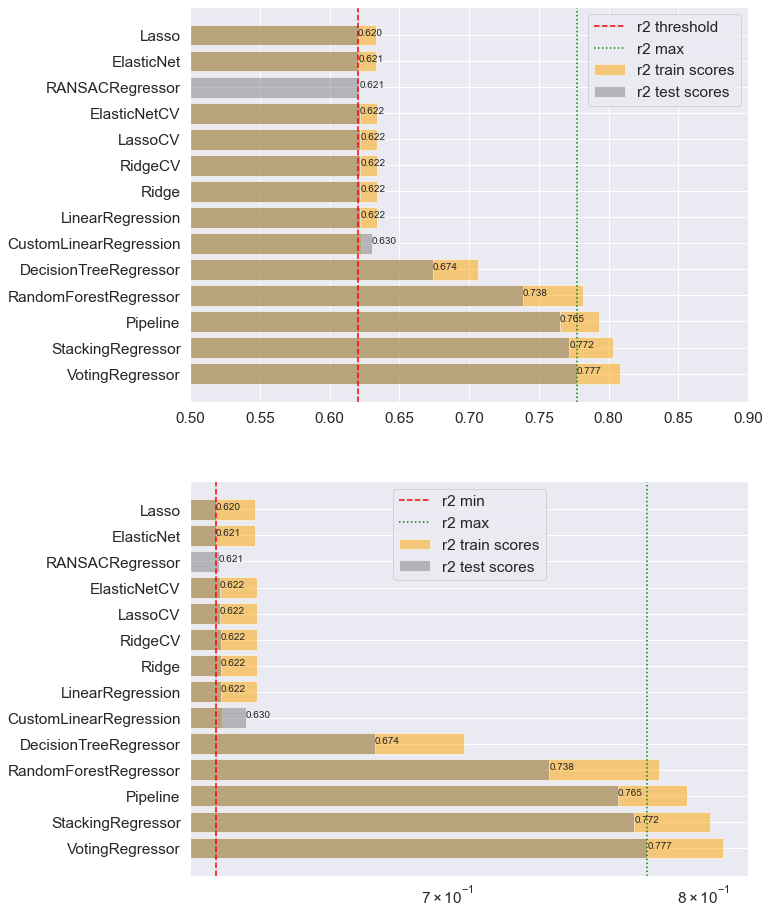

In [ ]:
plt.figure(figsize=(10, 16))
plt.subplot(2, 1, 1)
plt.barh(df_res.index, df_res['Train'], alpha=0.5, color='orange', label='r2 train scores')
plt.barh(df_res.index, df_res['Test'], alpha=0.5, color='gray', label='r2 test scores')
plt.axvline(df_res['Test'].min(), color='red', linestyle='--', label='r2 threshold')
plt.axvline(df_res['Test'].max(), color='green', linestyle=':', label='r2 max')
for index, value in enumerate(df_res['Test']):
    plt.text(value, index, f'{value:.3f}', fontsize=10)
plt.legend(loc='best')
plt.xlim([0.5, 0.9])
plt.subplot(2, 1, 2)
plt.barh(df_res.index, df_res['Train'], alpha=0.5, color='orange', label='r2 train scores')
plt.barh(df_res.index, df_res['Test'], alpha=0.5, color='gray', label='r2 test scores')
plt.axvline(df_res['Test'].min(), color='red', linestyle='--', label='r2 min')
plt.axvline(df_res['Test'].max(), color='green', linestyle=':', label='r2 max')
for index, value in enumerate(df_res['Test']):
    plt.text(value, index, f'{value:.3f}', fontsize=10)
plt.legend(loc='best')
plt.xscale('log')
plt.show()

In [ ]:
df_res['Overfitted%'] = (df_res['Test'] - df_res['Train']) / df_res['Train'] * 100
df_res

,Train,Test,Overfitted%
VotingRegressor,0.808210,0.776985,-3.863453
StackingRegressor,0.802731,0.771776,-3.856124
Pipeline,0.793376,0.765127,-3.560514
RandomForestRegressor,0.781909,0.738352,-5.570602
DecisionTreeRegressor,0.706031,0.674035,-4.531833
CustomLinearRegression,0.622522,0.630234,1.238894
LinearRegression,0.633996,0.622027,-1.887794
Ridge,0.633991,0.622012,-1.889594
RidgeCV,0.633991,0.622010,-1.889848
LassoCV,0.633961,0.621821,-1.915051


во всех моделях sklearn наблюдаются признаки переобучения (кроме созданной вручную), необходимо далее работать с набором данных и гиперпараметрами

In [ ]:
boost = GBReg(criterion='mse', max_depth=5, min_samples_leaf=40, learning_rate=0.1, random_state=1, n_estimators=400)
boost.fit(X_train_forest, y_train_forest)
y_train_pred = boost.predict(X_train_forest)
y_test_pred = boost.predict(X_test_forest)
print('R^2 при обучении: %.3f, при испытании: %.3f' % (r2_score(y_train_forest, y_train_pred), 
                                                       r2_score(y_test_forest, y_test_pred)))
r2_dict.update({boost.__class__.__name__: [r2_score(y_train_forest, y_train_pred),
                                         r2_score(y_test_forest, y_test_pred)]})

R^2 при обучении: 0.896, при испытании: 0.830


R2:	0.896
RMSE:	34480.75
MSE:	1188922098.852


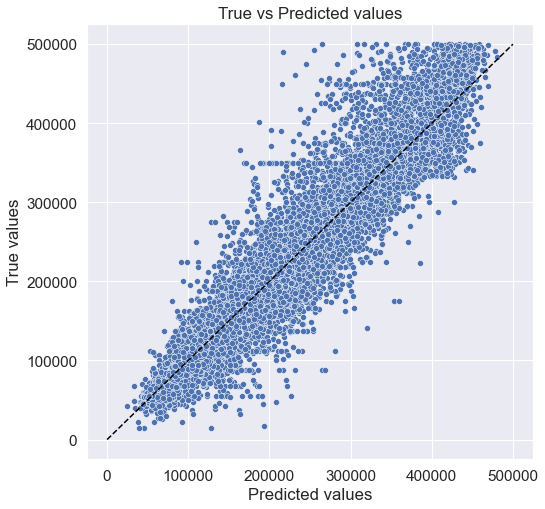

In [ ]:
evaluate_preds(y_train_forest, y_train_pred)

R2:	0.83
RMSE:	43922.606
MSE:	1929195277.752


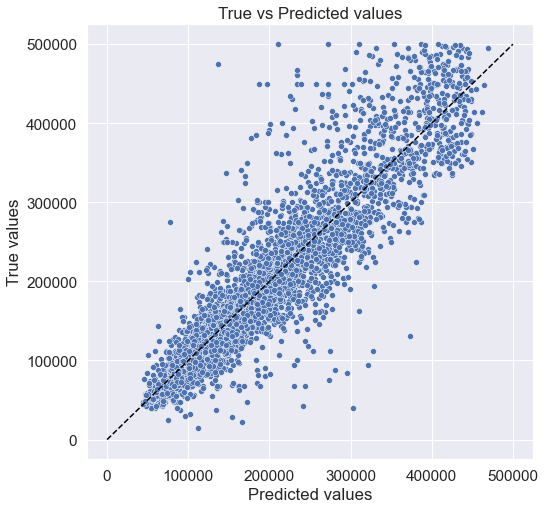

In [ ]:
evaluate_preds(y_test_forest, y_test_pred)

R2:	0.823
RMSE:	45089.126
MSE:	2033029299.695


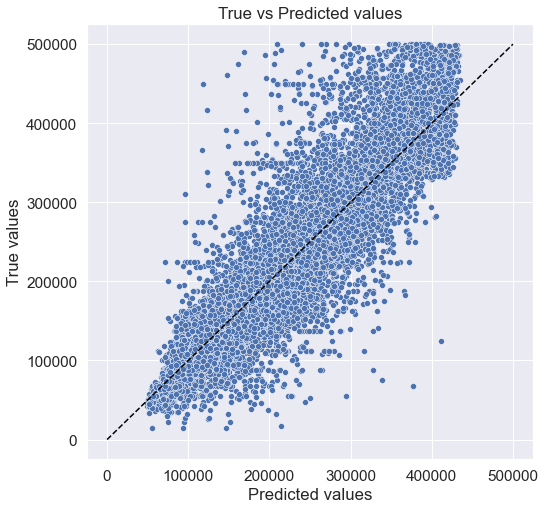

In [ ]:
rf_model = RFR(criterion='mse', max_depth=20, min_samples_leaf=30, random_state=1, n_estimators=100)
rf_model.fit(X_train_forest, y_train_forest)
y_train_preds = rf_model.predict(X_train_forest)
y_test_pred = rf_model.predict(X_test_forest)
evaluate_preds(y_train_forest, y_train_preds)
r2_dict.update({rf_model.__class__.__name__: [r2_score(y_train_forest, y_train_preds),
                                         r2_score(y_test_forest, y_test_pred)]})

R2:	0.779
RMSE:	50063.746
MSE:	2506378709.647


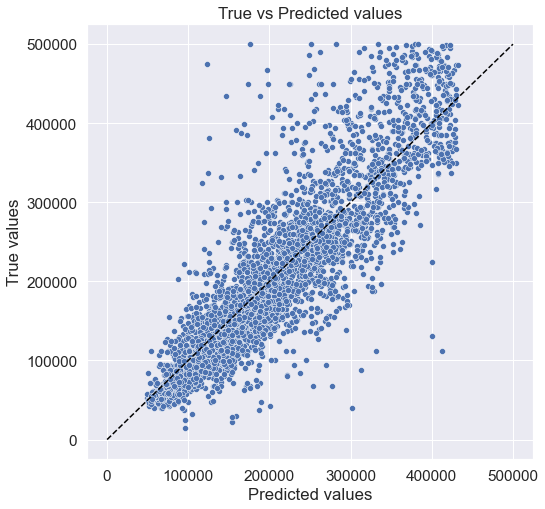

In [ ]:
evaluate_preds(y_test_forest, y_test_pred)

R2:	1.0
RMSE:	0.0
MSE:	0.0


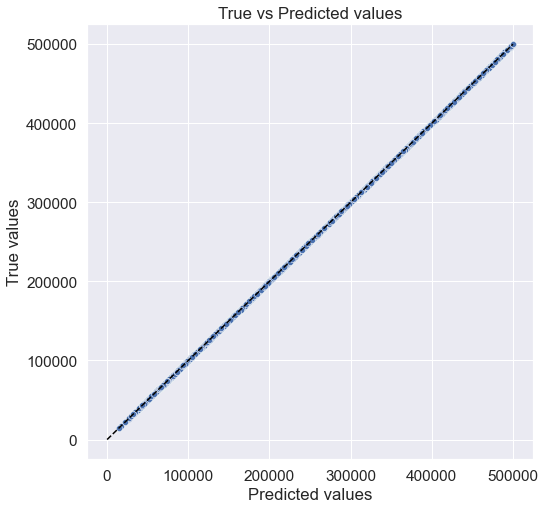

In [ ]:
dt_model = DTR(criterion='mse', max_depth=50, min_samples_leaf=1, random_state=1)
dt_model.fit(X_train_forest, y_train_forest)

y_train_preds = dt_model.predict(X_train_forest)
y_test_pred = dt_model.predict(X_test_forest)
r2_dict.update({dt_model.__class__.__name__: [r2_score(y_train_forest, y_train_pred),
                                         r2_score(y_test_forest, y_test_pred)]})
evaluate_preds(y_train_forest, y_train_preds)

R2:	0.635
RMSE:	64396.044
MSE:	4146850533.149


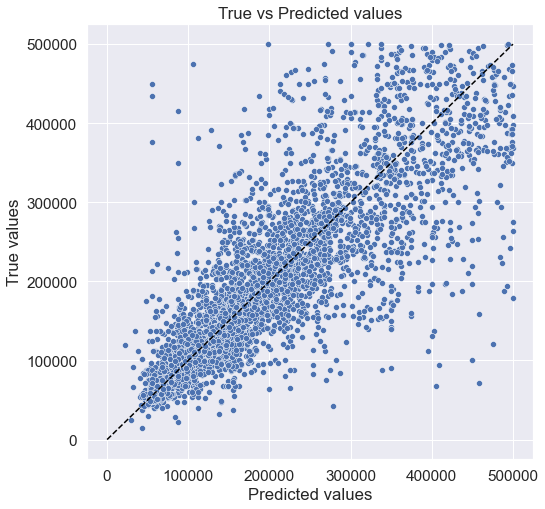

In [ ]:
evaluate_preds(y_test_forest, y_test_pred)

In [ ]:
reg1 = GBReg(criterion='mse', max_depth=4, min_samples_leaf=10, learning_rate=0.1, random_state=1, n_estimators=400)
reg2 = RFR(criterion='mse', max_depth=20, min_samples_leaf=30, random_state=1, n_estimators=100, n_jobs=-1)
reg3 = make_pipeline(StandardScaler(), LinearRegression())
reg4 = make_pipeline(RobustScaler(), KNNR(n_neighbors=20, p=1, metric='minkowski'))
reg5 = make_pipeline(StandardScaler(), ElasticNet(alpha=0.01, l1_ratio=0.9, random_state=1))
#reg4 = make_pipeline(StandardScaler(), Ridge(alpha=0.1, normalize=True random_state=1))
ereg = VoteReg(estimators=[('stack', reg), ('gb', reg1), ('rf', reg2), ('lr', reg3), ('knn', reg4), ('elanet', reg5)], weights=[0.2, 0.4, 0.4, 0.1, 0.4, 0.3])
ereg.fit(X_train_forest, y_train_forest)
y_train_pred = ereg.predict(X_train_forest)
y_test_pred = ereg.predict(X_test_forest)
print('R^2 при обучении: %.3f, при испытании: %.3f' % (r2_score(y_train_forest, y_train_pred), 
                                                       r2_score(y_test_forest, y_test_pred)))
r2_dict.update({ereg.__class__.__name__: [r2_score(y_train_forest, y_train_pred),
                                          r2_score(y_test_forest, y_test_pred)]})

R^2 при обучении: 0.821, при испытании: 0.785


R2:	0.868
RMSE:	38896.338
MSE:	1512925090.129
MSE_scaled:	8377.215


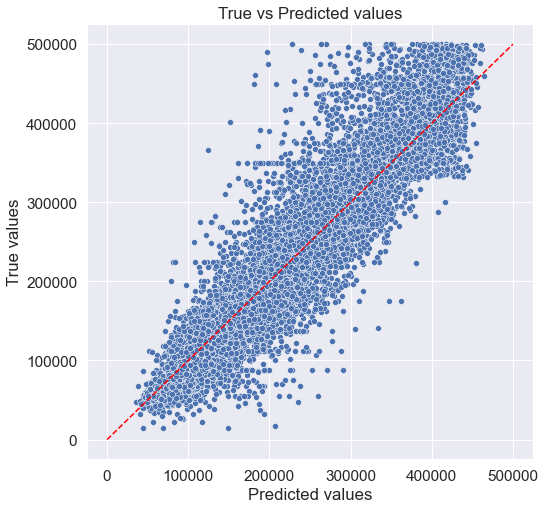

R2:	0.827
RMSE:	44283.658
MSE:	1961042330.397
MSE_scaled:	11135.959


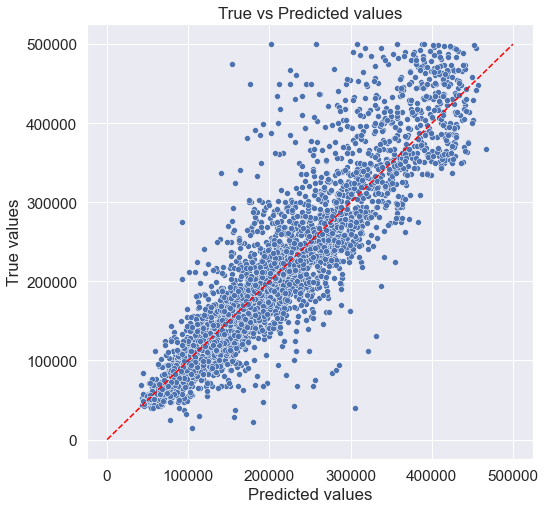

In [ ]:
bag = BaggingRegressor(base_estimator=GBReg(criterion='mse', max_depth=4, min_samples_leaf=30, learning_rate=0.1, random_state=1, n_estimators=400), n_estimators=35, max_features=7, random_state=1)
bag.fit(X_train_forest, y_train_forest)
y_train_pred = bag.predict(X_train_forest)
y_test_pred = bag.predict(X_test_forest)
evaluate_preds(y_train_forest, y_train_pred)
evaluate_preds(y_test_forest, y_test_pred)
r2_dict.update({bag.__class__.__name__: [r2_score(y_train_forest, y_train_pred),
                                         r2_score(y_test_forest, y_test_pred)]})

In [ ]:
df_res = pd.DataFrame(r2_dict).transpose()
df_res.columns = ['Train', 'Test']
df_res.sort_values(by=['Test', 'Train'], ascending=False, inplace=True)
df_res['diff'] = df_res['Test'] - df_res['Train']

In [ ]:
df_res

,Train,Test,diff
GradientBoostingRegressor,0.896257,0.829993,-0.066264
BaggingRegressor,0.821447,0.827186,0.005740
VotingRegressor,0.821447,0.785253,-0.036194
RandomForestRegressor,0.822602,0.779130,-0.043473
StackingRegressor,0.802731,0.771776,-0.030954
DecisionTreeRegressor,0.896257,0.634566,-0.261691
Pipeline,0.896257,0.634566,-0.261691
CustomLinearRegression,0.622522,0.630234,0.007712
LinearRegression,0.633996,0.622027,-0.011969
Ridge,0.633991,0.622012,-0.011980


In [ ]:
feature_importances = pd.DataFrame(zip(['median_income', 'lonlat', 'population_per_room', 'latitude', 'longitude', 'bedroom_share',
              'housing_median_age', 'households'], 
                                       boost.feature_importances_), 
                                   columns=['feature_name', 'importance'])

feature_importances.sort_values(by='importance', ascending=False, inplace=True)
feature_importances.head(5)

,feature_name,importance
0,median_income,0.470936
1,lonlat,0.251792
2,population_per_room,0.090400
4,longitude,0.062890
3,latitude,0.061415


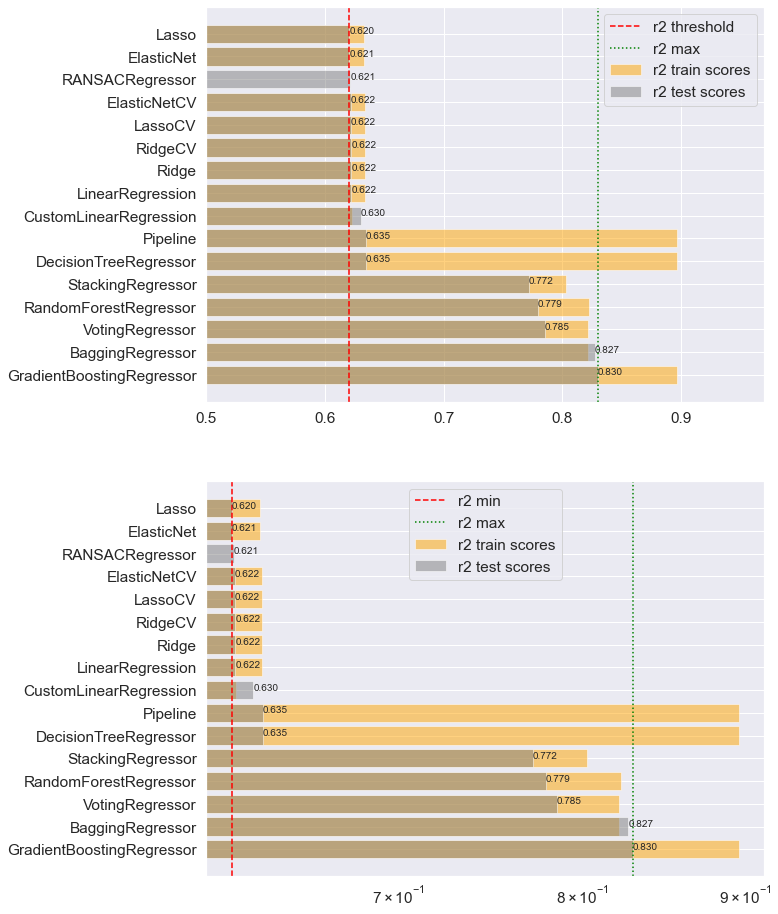

In [ ]:
plt.figure(figsize=(10, 16))
plt.subplot(2, 1, 1)
plt.barh(df_res.index, df_res['Train'], alpha=0.5, color='orange', label='r2 train scores')
plt.barh(df_res.index, df_res['Test'], alpha=0.5, color='gray', label='r2 test scores')
plt.axvline(df_res['Test'].min(), color='red', linestyle='--', label='r2 threshold')
plt.axvline(df_res['Test'].max(), color='green', linestyle=':', label='r2 max')
for index, value in enumerate(df_res['Test']):
    plt.text(value, index, f'{value:.3f}', fontsize=10)
plt.legend(loc='best')
plt.xlim([0.5, 0.97])
plt.subplot(2, 1, 2)
plt.barh(df_res.index, df_res['Train'], alpha=0.5, color='orange', label='r2 train scores')
plt.barh(df_res.index, df_res['Test'], alpha=0.5, color='gray', label='r2 test scores')
plt.axvline(df_res['Test'].min(), color='red', linestyle='--', label='r2 min')
plt.axvline(df_res['Test'].max(), color='green', linestyle=':', label='r2 max')
for index, value in enumerate(df_res['Test']):
    plt.text(value, index, f'{value:.3f}', fontsize=10)
plt.legend(loc='best')
plt.xscale('log')
plt.show()

In [ ]:
for clf in (boost, bag, ereg):
    scores = cross_val_score(estimator=clf, X=X_train_forest, y=y_train_forest, scoring='r2', cv=5, n_jobs=-1)
    print(f'Accuracy on cross_validation: {np.mean(scores)} +/- {np.std(scores)}')

Accuracy on cross_validation: 0.8298602393605379 +/- 0.006582255116671719
Accuracy on cross_validation: 0.8277491357561557 +/- 0.008301926042295231
Accuracy on cross_validation: 0.7889767471134942 +/- 0.009506672746565985


In [ ]:
y_test_pred_boost = boost.predict(X_test_forest)
y_test_pred_bag = bag.predict(X_test_forest)
y_test_pred_vote = ereg.predict(X_test_forest)

In [ ]:
df_compare = pd.DataFrame(y_test_forest, columns=['true value'])
for idx, loc_frame in enumerate((y_test_pred_boost, y_test_pred_bag, y_test_pred_vote), 1):
    df_pred = pd.DataFrame(loc_frame, columns=[f'{idx}'])
    df_compare = pd.concat([df_compare, df_pred], axis=1)
    df_compare[f'error_{idx}'] = (df_compare.iloc[:, -1] - df_compare.iloc[:, 0]) / df_compare.iloc[:, 0] * 100
df_compare = df_compare.apply(lambda x: round(x, 2))
df_compare.sort_values(by='true value', ascending=False, inplace=True)
df_compare.describe()

,true value,1,error_1,2,error_2,3,error_3
count,4128.000000,4128.000000,4128.000000,4128.000000,4128.000000,4128.000000,4128.000000
mean,199708.718750,199728.542633,5.512834,199562.942459,6.085984,199811.747040,8.312919
std,106538.664062,96954.811249,32.446184,94164.072354,32.725498,88228.786428,34.909594
min,14999.000000,43632.370000,-71.870000,41502.560000,-67.490000,36994.900000,-68.510000
25%,116300.000000,124372.050000,-8.692500,126187.980000,-7.935000,132436.535000,-8.290000
50%,176100.000000,180461.885000,2.445000,181809.685000,3.135000,186583.360000,4.955000
75%,259625.000000,260502.977500,14.182500,258556.125000,15.322500,256073.677500,19.162500
max,500000.000000,469002.990000,658.800000,467148.980000,699.430000,464704.100000,698.330000


In [ ]:
df_compare[['error_1', 'error_2', 'error_3']].sum(axis=0)

error_1    22756.98
error_2    25122.94
error_3    34315.73
dtype: float64

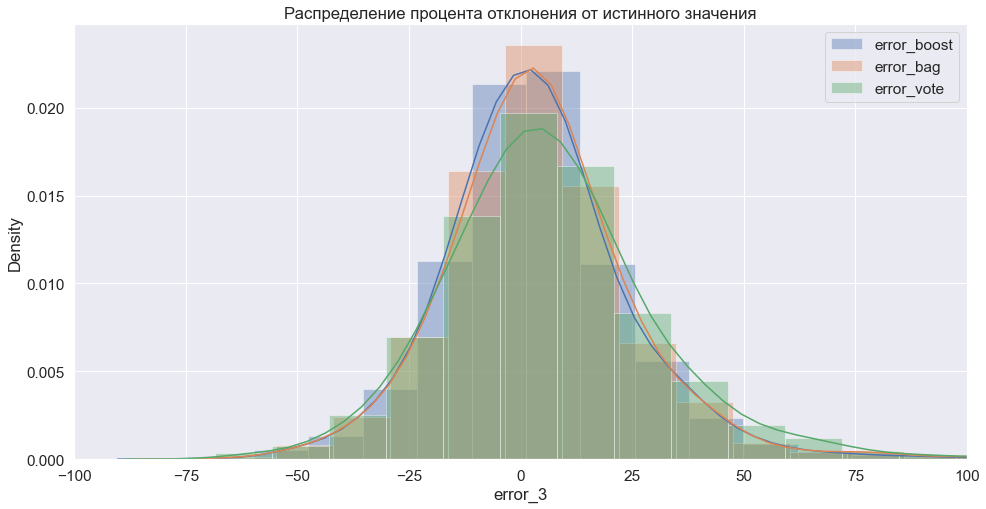

In [ ]:
plt.figure(figsize = (16, 8))
sns.distplot(df_compare['error_1'], bins=60, label='error_boost')
sns.distplot(df_compare['error_2'], bins=60, label='error_bag')
sns.distplot(df_compare['error_3'], bins=60, label='error_vote')
plt.title('Распределение процента отклонения от истинного значения')
plt.legend(loc='upper right')
plt.xlim([-100, 100])
#plt.xscale('log')
plt.show()

попробуем повыбирать признаки с sklearn

In [ ]:
X.shape, y.shape

((20640, 18), (20640,))

In [ ]:
# проверим выбор признаокв еще раз
rfe_selector = RFE(estimator=RFR(criterion='mse', max_depth=20, min_samples_leaf=30, 
                                 random_state=1, n_estimators=100), n_features_to_select=11, step=1)
rfe_selector = rfe_selector.fit(X, y)

In [ ]:
ranked_features = rfe_selector.ranking_
raw_columns = np.where(ranked_features == 1, df.columns[:-1], None)
raw_columns = raw_columns[raw_columns != None]
X_rfe = df[raw_columns].values
X_rfe.shape

(20640, 11)

In [ ]:
X_train_, X_test_, y_train_, y_test_ = train_test_split(X_rfe, y, test_size=.3, shuffle=True, random_state=1)

In [ ]:
X_train_.shape, X_test_.shape, y_train_.shape, y_test_.shape

((14448, 11), (6192, 11), (14448,), (6192,))

R2:	0.86
RMSE:	40069.744
MSE:	1605584363.763


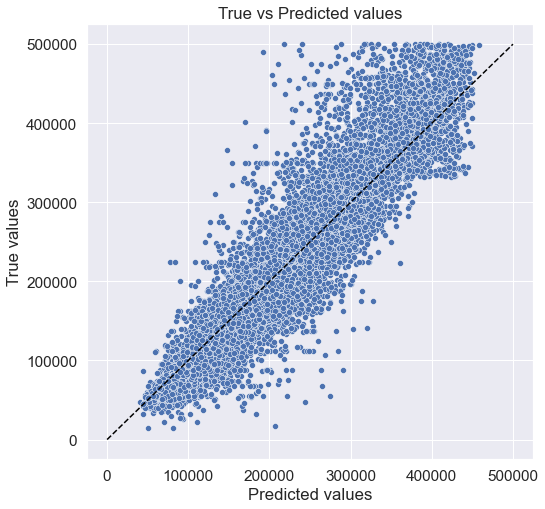

R2:	0.816
RMSE:	45648.61
MSE:	2083795585.164


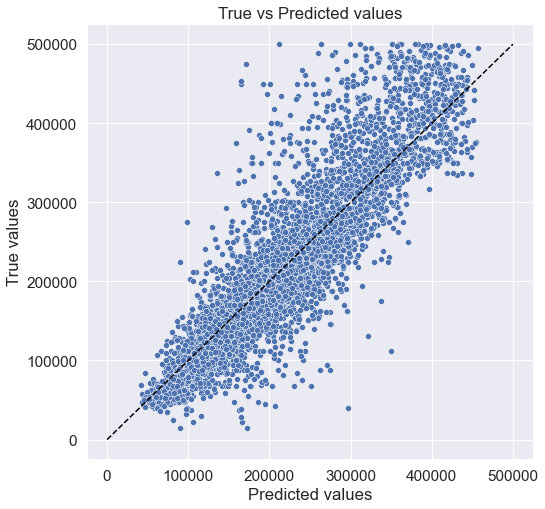

In [ ]:
bag_ = BaggingRegressor(base_estimator=GBReg(criterion='mse', max_depth=4, min_samples_leaf=30, learning_rate=0.1, random_state=1, n_estimators=400), n_estimators=35, max_features=7, random_state=1)
bag_.fit(X_train_, y_train_)
y_train_pred = bag_.predict(X_train_)
y_test_pred = bag_.predict(X_test_)
evaluate_preds(y_train_, y_train_pred)
evaluate_preds(y_test_, y_test_pred)

In [ ]:
sfs = SequentialFeatureSelector(RFR(criterion='mse', max_depth=20, min_samples_leaf=30, 
                                 random_state=1, n_estimators=100), n_features_to_select=11, 
                                scoring='r2', cv=3, n_jobs=-1)
sfs.fit(X, y)

SequentialFeatureSelector(cv=3,
                          estimator=RandomForestRegressor(max_depth=20,
                                                          min_samples_leaf=30,
                                                          random_state=1),
                          n_features_to_select=11, n_jobs=-1, scoring='r2')

In [ ]:
indices = sfs.get_support(indices=True)
cols = np.array(df.columns)[indices]

In [ ]:
X_sfs = df[[*cols]].values
X_train, X_test, y_train, y_test = train_test_split(X_sfs, y, test_size=0.2, shuffle=True, random_state=1)

In [ ]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((16512, 11), (4128, 11), (16512,), (4128,))

R2:	0.775
RMSE:	50754.038
MSE:	2575972395.192


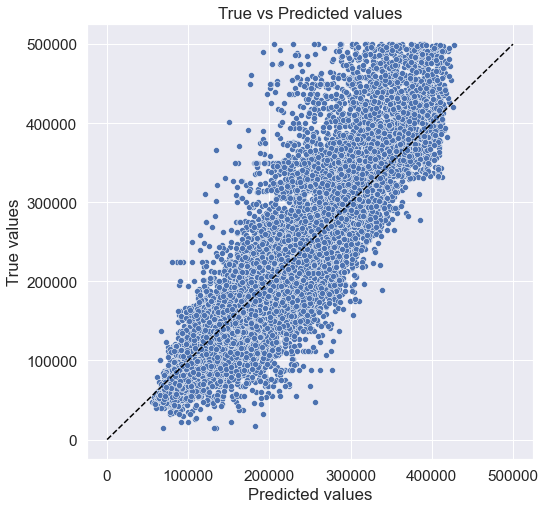

R2:	0.725
RMSE:	55894.927
MSE:	3124242871.407


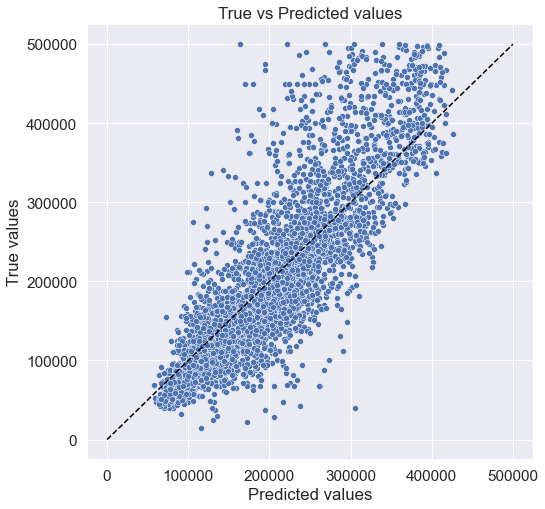

In [ ]:
bag_sfs = BaggingRegressor(base_estimator=GBReg(criterion='mse', max_depth=4, min_samples_leaf=30, learning_rate=0.1, random_state=1, n_estimators=400), n_estimators=35, max_features=7, random_state=1)
bag_sfs.fit(X_train, y_train)
y_train_pred = bag_sfs.predict(X_train)
y_test_pred = bag_sfs.predict(X_test)
evaluate_preds(y_train, y_train_pred)
evaluate_preds(y_test, y_test_pred)

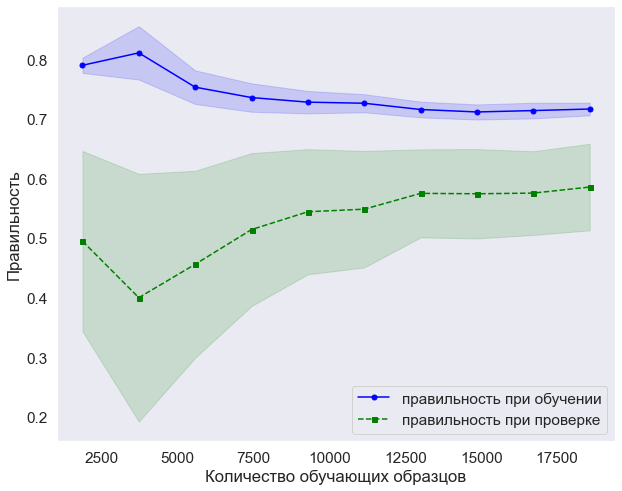

In [ ]:
from sklearn.model_selection import learning_curve
# позволяет определить количество образцов для оптимального соотношения правильности при обучении и проверке
#estimator = make_pipeline(StandardScaler(), LinearRegression())
#estimator = GBReg(criterion='mse', max_depth=3, min_samples_leaf=5, learning_rate=0.1, random_state=1, n_estimators=50)
estimator = RFR(criterion='mse', max_depth=6, min_samples_leaf=30, random_state=1, n_estimators=200)
#estimator = BaggingRegressor(base_estimator=GBReg(criterion='mse', max_depth=4, min_samples_leaf=10, learning_rate=0.1, random_state=1, n_estimators=400), n_estimators=35, max_features=5, random_state=1)
train_sizes, train_scores, test_scores = learning_curve(estimator=estimator, X=X_, y=y_, 
                                                        train_sizes=np.linspace(0.1, 1.0, 10), cv=10, n_jobs=-1)
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)
plt.figure(figsize=(10, 8))
plt.plot(train_sizes, train_mean, color='blue', marker='o', markersize=5, label='правильность при обучении')
plt.fill_between(train_sizes, train_mean + train_std, train_mean - train_std, alpha=0.15, color='blue')
plt.plot(train_sizes, test_mean, color='green', linestyle='--', marker='s', markersize=5, 
         label='правильность при проверке')
plt.fill_between(train_sizes, test_mean + test_std, test_mean - test_std, alpha=0.15, color='green')
plt.grid()
plt.xlabel('Количество обучающих образцов')
plt.ylabel('Правильность')
plt.legend(loc='lower right')
plt.show()

<h3>Вывод</h3>
Две модели показали себя лучше остальных: GradientBoostingRegressor, BaggingRegressor
Первая модель переобучилась, но все же выдала немного более точный результат при предсказании на тестовом наборе.
Остановимся на этом варианте.

R2:	0.889
RMSE:	35699.967
MSE:	1274487664.031
MSE_scaled:	7056.964


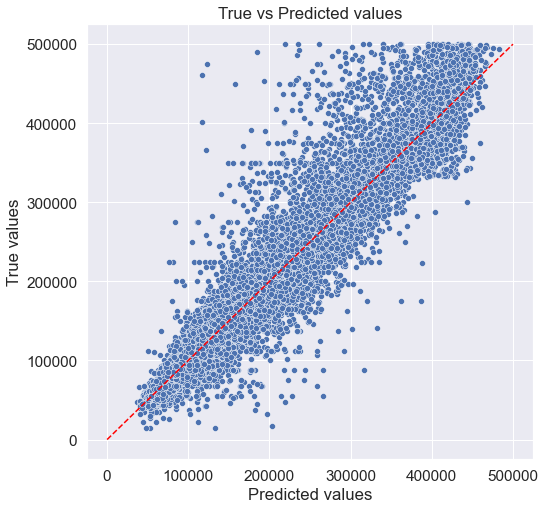

R2:	0.833
RMSE:	43569.094
MSE:	1898265929.965
MSE_scaled:	10779.477


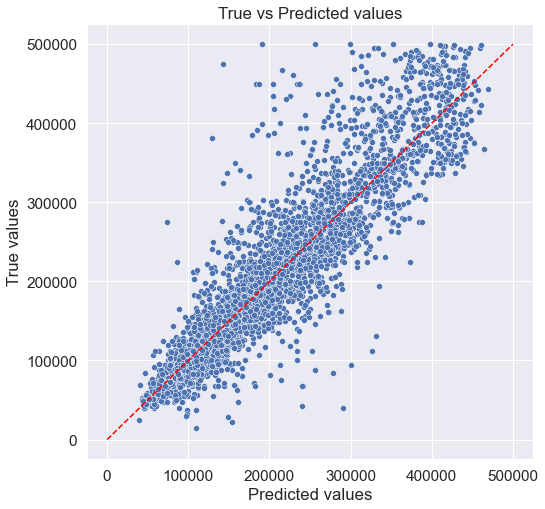

CPU times: user 2min 9s, sys: 1.23 s, total: 2min 11s
Wall time: 2min 27s


In [ ]:
%%time
gb_model = GBReg(criterion='mse',
                max_depth=5,
                min_samples_leaf=50,
                random_state=1,  
                n_estimators=2500, 
                max_features='sqrt', 
                loss='huber', 
                learning_rate=0.025)
gb_model.fit(X_train_forest, y_train_forest)
y_train_pred = gb_model.predict(X_train_forest)
y_test_pred = gb_model.predict(X_test_forest)
evaluate_preds(y_train_forest, y_train_pred)
evaluate_preds(y_test_forest, y_test_pred)

Кластеризация

In [ ]:
import folium
import geopy

In [ ]:
region = "California"
locator = geopy.geocoders.Nominatim(user_agent="California housing")
location = locator.geocode(region)
location = [location.latitude, location.longitude]

In [ ]:
scaler = MinMaxScaler(feature_range=(2,8))
df['size'] = scaler.fit_transform(df['median_house_value'].values.reshape(-1, 1)).reshape(-1)

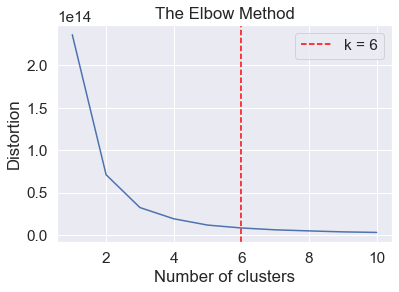

In [ ]:
df_cl = df[['lonlat', 'median_income', 'population_per_room', 'housing_median_age', 'median_house_value']]
X_cl = df_cl.values
distortions = []
max_k = 10
for i in range(1, max_k + 1):
    if len(X) >= i:
        kmeans = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=300, random_state=0, tol=1e-04)
        kmeans.fit(X_cl)
        distortions.append(kmeans.inertia_)

k = [i*100 for i in np.diff(distortions, 2)].index(min([i*100 for i in np.diff(distortions,2)]))

fig, ax = plt.subplots()
ax.plot(range(1, 11), distortions)
ax.axvline(k, ls='--', color="red", label="k = " + str(k))
ax.set(title='The Elbow Method', xlabel='Number of clusters', ylabel="Distortion")
plt.legend(loc='best')
plt.show()

In [ ]:
kmeans = KMeans(n_clusters=6, init='k-means++', n_init=10, max_iter=300, random_state=0, tol=1e-04)
df['cluster'] = kmeans.fit_predict(X_cl)

In [ ]:
new_map = folium.Map(location=location, zoom_start=6)
for idx, row in df.iterrows():
    current = [row['latitude'], row['longitude']]
    color = color_dict[row['cluster']]
    folium.CircleMarker(location=current, fill=True, color = color, 
                        radius = row['size'], popup=f"{row['median_house_value']} $").add_to(new_map)

In [ ]:
new_map

In [ ]:
columns = ['Cluster', 'Mean_value', 'Median_value', 'Count', 'Mode', 'Income']
result = pd.DataFrame(columns = columns)
for x in set(df['cluster']):
    cluster_df = df.loc[df['cluster'] == x]
    result.loc[x] = [x, cluster_df['median_house_value'].mean(), cluster_df['median_house_value'].median(), 
                     cluster_df['median_house_value'].count(), cluster_df['median_house_value'].mode()[0], 
                    cluster_df['median_income'].mean()]
result['Mean_value'] = result['Mean_value'].apply(lambda x: round(x, 2))
result['Count'] = result['Count'].astype(np.int16)
result

,Cluster,Mean_value,Median_value,Count,Mode,Income
0,0.0,147082.75,147800.0,5160,137500.0,3.272505
1,1.0,350483.94,350000.0,2222,350000.0,5.665520
2,2.0,204176.06,202900.0,4079,187500.0,3.887900
3,3.0,84404.45,87500.0,4855,112500.0,2.416158
4,4.0,444160.94,442100.0,1429,450000.0,6.648629
5,5.0,267199.09,266200.0,2895,275000.0,4.602992


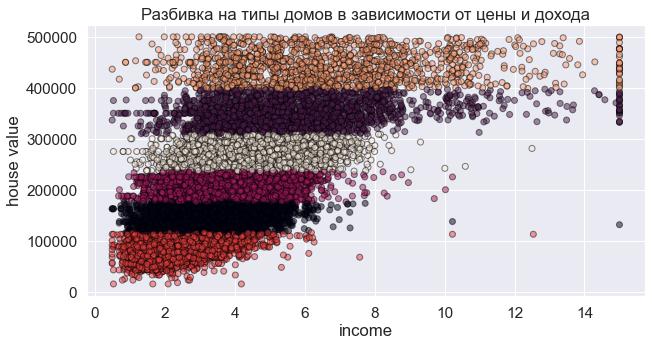

In [ ]:
fig, ax = plt.subplots(figsize=(10, 5))
col = kmeans.predict(X_cl)
ax.scatter(df['median_income'].values, df['median_house_value'].values, c=col,
          alpha=0.5, ec='black')
ax.set_title('Разбивка на типы домов в зависимости от цены и дохода')
ax.set_ylabel('house value')
ax.set_xlabel('income')
plt.show()

In [ ]:
#DBSCAN не подойдет, так как для большой локации установить соотношение между eps (расстояние до соседней точки в кластере) и
# min_samples (минимальное количество точек в кластере) затруднительно - либо будет много кластеров и это плохо, либо будет 
# много отрицательных значений - то есть точка не попала в кластер и причислена к noise (шуму)
# возможно пробовать различные метрики расстояния
db = DBSCAN(eps=0.1, min_samples=2, metric='cosine') # [‘cityblock’, ‘cosine’, ‘euclidean’, ‘l1’, ‘l2’, ‘manhattan’]
df['cluster_db'] = db.fit_predict(X_cl)

In [ ]:
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,unknown,<1H OCEAN,...,ISLAND,NEAR BAY,NEAR OCEAN,lonlat,bedroom_share,population_per_room,median_house_value,cluster,size,cluster_db
0,-122.230003,37.880001,41.0,880.0,129.0,322.0,126.0,8.3252,0,0,...,0,1,0,-84.350006,14.659090,0.365909,452600.0,5,13.827197,-1
1,-122.220001,37.860001,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,0,0,...,0,1,0,-84.360001,15.579659,0.338217,358500.0,0,11.498959,-1
2,-122.239998,37.849998,52.0,1467.0,190.0,496.0,177.0,7.2574,0,0,...,0,1,0,-84.389999,12.951602,0.338105,352100.0,0,11.340609,-1
3,-122.250000,37.849998,52.0,1274.0,235.0,558.0,219.0,5.6431,0,0,...,0,1,0,-84.400002,18.445841,0.437991,341300.0,0,11.073394,-1
4,-122.250000,37.849998,52.0,1627.0,280.0,565.0,259.0,3.8462,0,0,...,0,1,0,-84.400002,17.209587,0.347265,342200.0,0,11.095661,-1


In [ ]:
df.loc[df['cluster_db'] < 0, 'cluster_db'].value_counts()

-1    19648
Name: cluster_db, dtype: int64

In [ ]:
df['cluster_db'].value_counts()

0    20640
Name: cluster_db, dtype: int64

In [ ]:
df.drop('cluster_db', axis=1, inplace=True)

In [ ]:
df.head(1)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,unknown district,<1H OCEAN,...,ISLAND,NEAR BAY,NEAR OCEAN,lonlat,bedroom_share,population_per_room,city,median_house_value,cluster,size
0,-122.230003,37.880001,41.0,880.0,129.0,322.0,126.0,8.3252,0,0,...,0,1,0,-84.350006,14.65909,0.365909,0,452600.0,4,9.218145


In [ ]:
df.to_csv('housing_clustered.csv', index=False, encoding='utf-8')